In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
from scipy.stats import shapiro
import warnings
warnings.filterwarnings('ignore')

In [9]:
# 1. Load Datasheet
import pandas as pd
df = pd.read_csv("Breast_Cancer_Wisconsin_Assignment.csv")

In [11]:
df.info()

#extra
# Viewing the first few rows
print(df.head())

# Viewing the last few rows
print(df.tail())


# Descriptive statistics for numerical columns
print(df.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ID                       569 non-null    int64  
 1   Diagnosis                569 non-null    object 
 2   Radius                   568 non-null    float64
 3   Texture                  569 non-null    float64
 4   Perimeter                568 non-null    float64
 5   Area                     568 non-null    float64
 6   Smoothness               568 non-null    float64
 7   Compactness              569 non-null    float64
 8   Concavity                569 non-null    float64
 9   Concave points           568 non-null    float64
 10  Symmetry                 569 non-null    float64
 11  Fractal_dimension        569 non-null    float64
 12  SE Radius                568 non-null    float64
 13  SE Texture               568 non-null    float64
 14  SE Perimeter             5

In [13]:
sns.set(style="whitegrid")

In [19]:
missing_before = df.isnull().sum()
missing_before = missing_before[missing_before > 0]
plt.show()

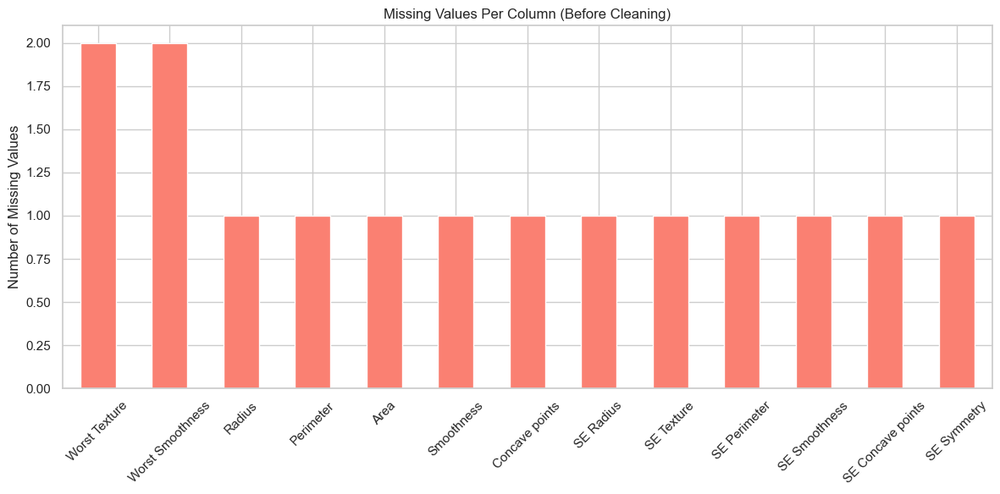

In [21]:
# Plot missing data before cleaning

plt.figure(figsize=(12, 6))
missing_before.sort_values(ascending=False).plot(kind='bar', color='salmon')
plt.title('Missing Values Per Column (Before Cleaning)')
plt.ylabel('Number of Missing Values')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [23]:
#Identify data types
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = df.select_dtypes(include=['object']).columns

In [25]:
#Handle Missing Values
df_cleaned = df.copy()

In [27]:
# For numerical columns
for col in numerical_cols:
    if df_cleaned[col].isnull().sum() > 0:
        if df_cleaned[col].skew() > 1 or df_cleaned[col].skew() < -1:
            df_cleaned[col].fillna(df_cleaned[col].median(), inplace=True)
        else:
            df_cleaned[col].fillna(df_cleaned[col].mean(), inplace=True)

In [29]:
# For categorical columns
for col in categorical_cols:
    if df_cleaned[col].isnull().sum() > 0:
        df_cleaned[col].fillna(df_cleaned[col].mode()[0], inplace=True)

In [31]:
# a) Visualize missing values after cleaning
missing_after = df_cleaned.isnull().sum()
missing_after = missing_after[missing_after > 0]

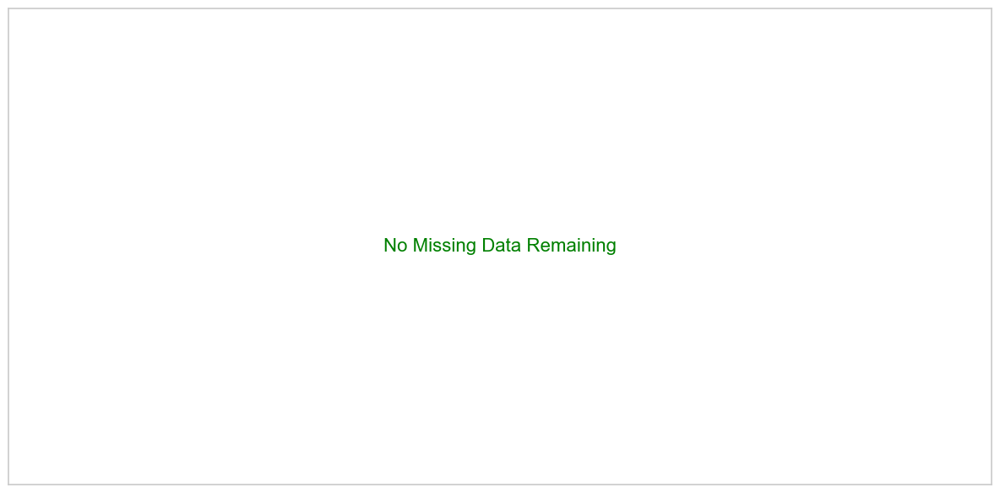

In [33]:
# Plot missing data after cleaning (should be empty or very small)
plt.figure(figsize=(12, 6))
if not missing_after.empty:
    missing_after.sort_values(ascending=False).plot(kind='bar', color='mediumseagreen')
    plt.title('Missing Values Per Column (After Cleaning)')
    plt.ylabel('Number of Missing Values')
    plt.xticks(rotation=45)
else:
    plt.text(0.5, 0.5, 'No Missing Data Remaining', horizontalalignment='center',
             verticalalignment='center', fontsize=16, color='green', transform=plt.gca().transAxes)
    plt.gca().axes.xaxis.set_visible(False)
    plt.gca().axes.yaxis.set_visible(False)
plt.tight_layout()
plt.show()

In [35]:
# Justification summary
justification = {
    "Numerical columns": "Mean imputation was used for roughly symmetric distributions; median for skewed data.",
    "Categorical columns": "Mode (most frequent value) was used to fill missing values."
}

In [51]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import zscore

In [37]:
# Select only numerical columns
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
df_numeric = df[numerical_cols].copy()

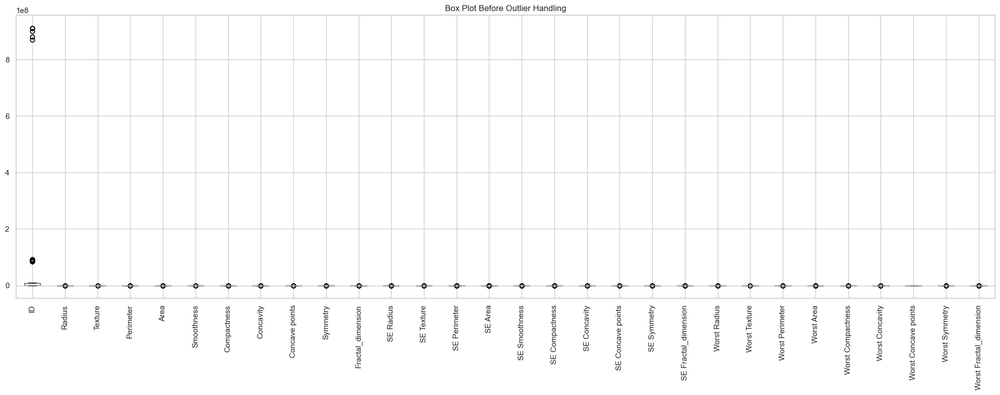

In [47]:
# a) Box Plots Before Handling Outliers
plt.figure(figsize=(20, 8))
df_numeric.boxplot(rot=90)
plt.title("Box Plot Before Outlier Handling")
plt.tight_layout()
plt.show()

In [57]:
# b) Calculate Z-scores to Identify Outliers
z_scores = np.abs(zscore(df_numeric))
outliers = (z_scores > 3)
outlier_rows = outliers.any(axis=1)
print(f"Total rows with at least one extreme outlier (|z| > 3): {outlier_rows.sum()}")

Total rows with at least one extreme outlier (|z| > 3): 66


In [59]:
#c) Handle Outliers
# Cap values at the 1st and 99th percentiles
df_capped = df_numeric.copy()
for col in df_capped.columns:
    lower_cap = df_capped[col].quantile(0.01)
    upper_cap = df_capped[col].quantile(0.99)
    df_capped[col] = np.where(df_capped[col] < lower_cap, lower_cap, df_capped[col])
    df_capped[col] = np.where(df_capped[col] > upper_cap, upper_cap, df_capped[col])

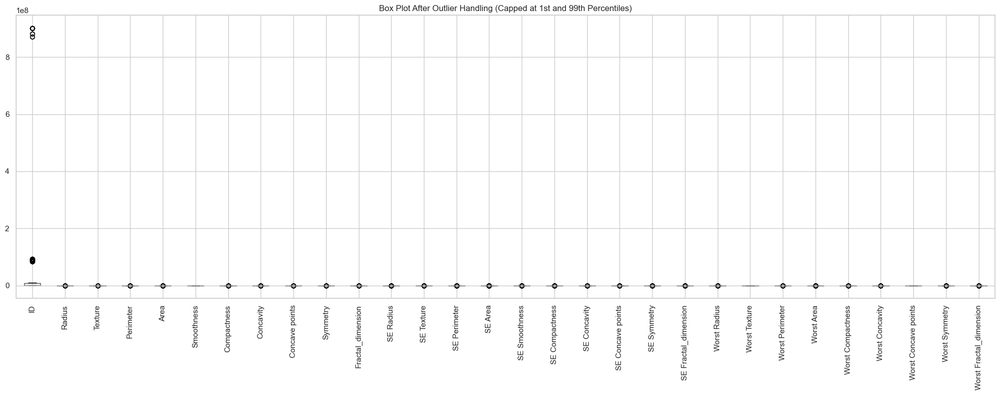

In [63]:
# Visualization After Handling Outliers
plt.figure(figsize=(20, 8))
df_capped.boxplot(rot=90)
plt.title("Box Plot After Outlier Handling (Capped at 1st and 99th Percentiles)")
plt.tight_layout()
plt.show()

In [75]:
 #3. Univariate Analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import shapiro, normaltest

In [67]:
# Identify numerical and categorical columns
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = df.select_dtypes(include=['object']).columns

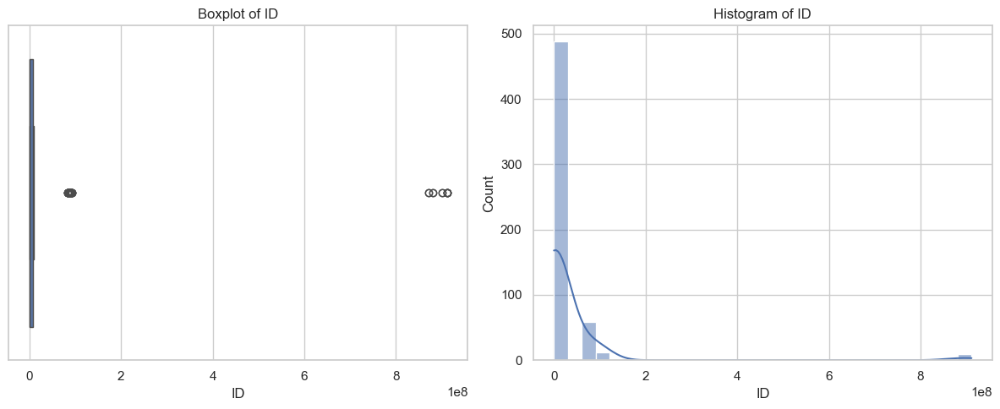

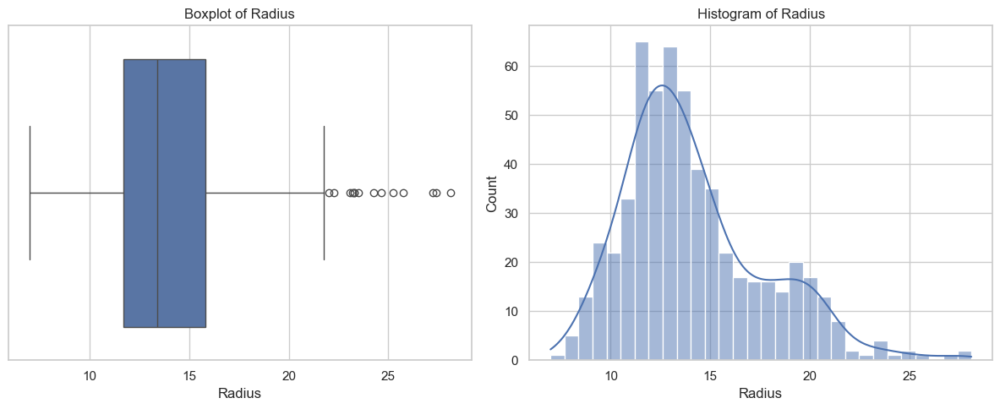

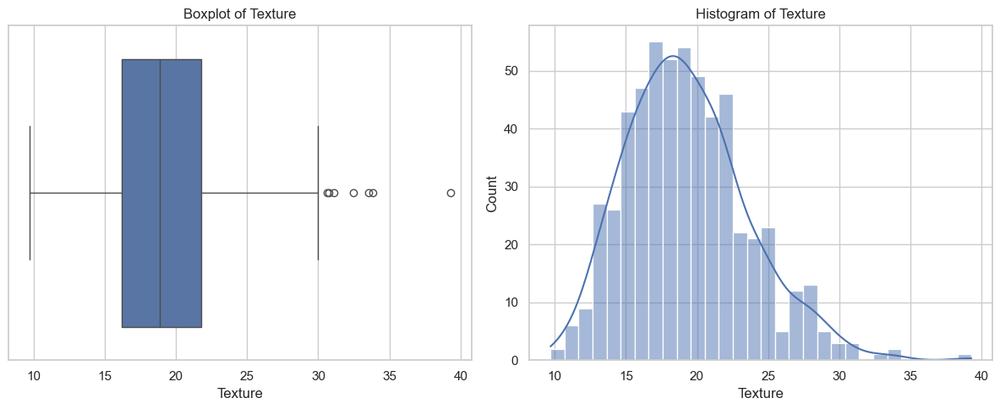

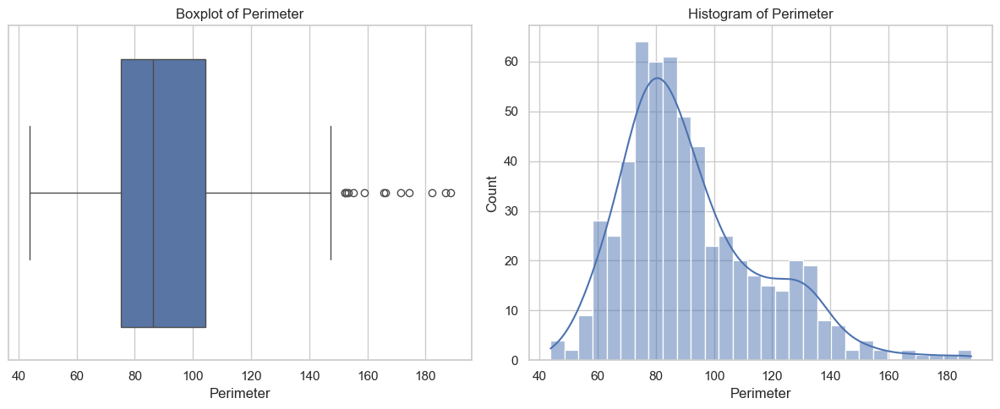

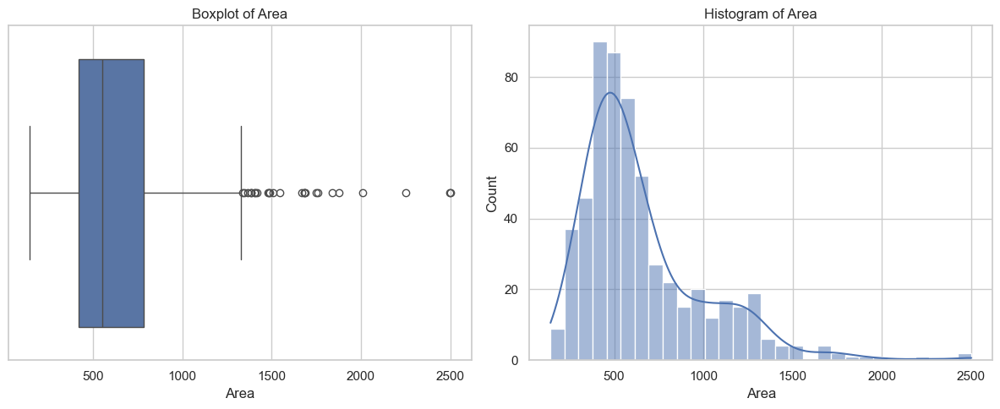

...

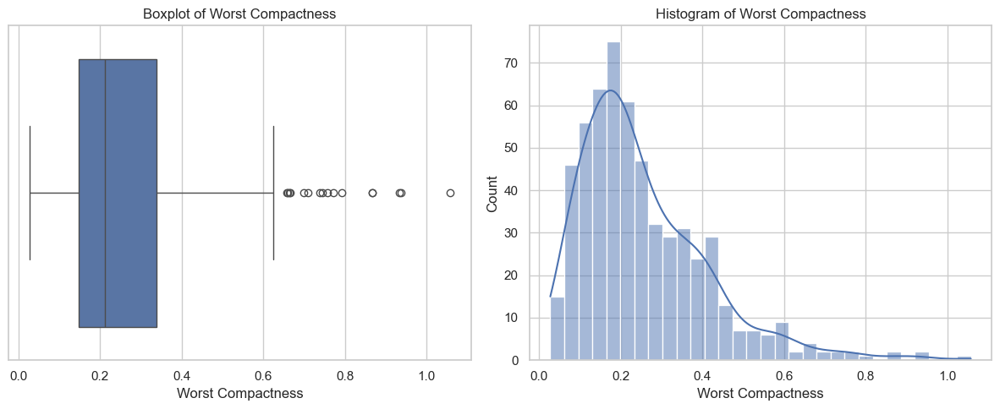

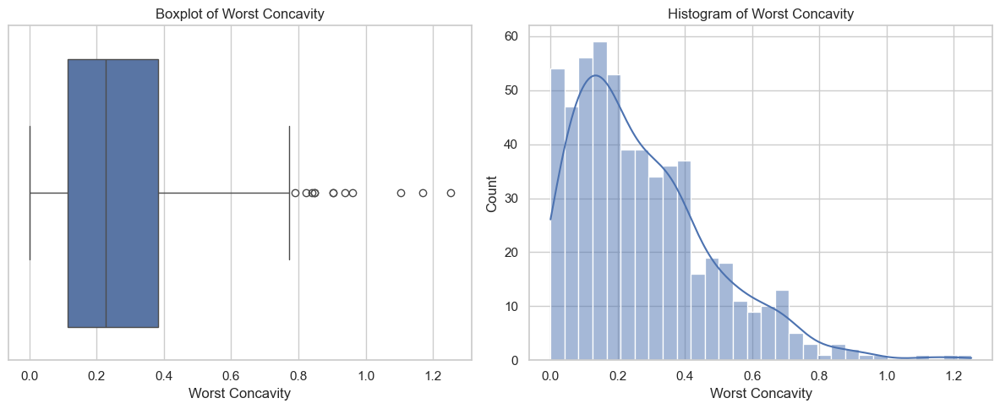

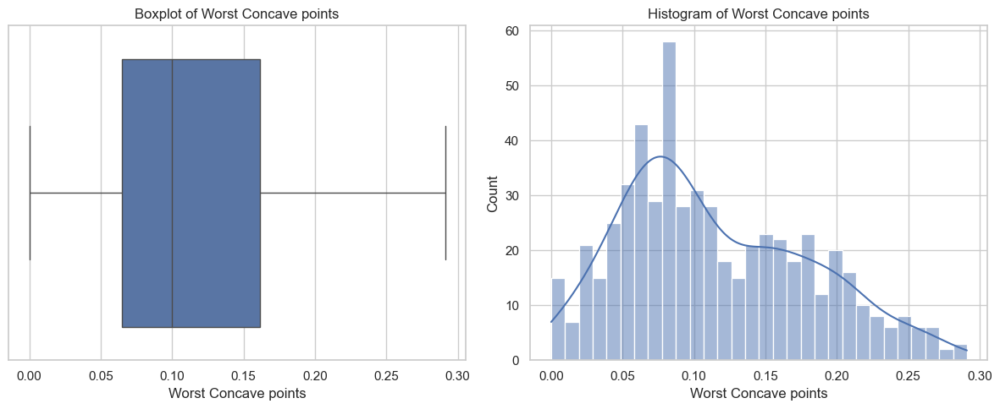

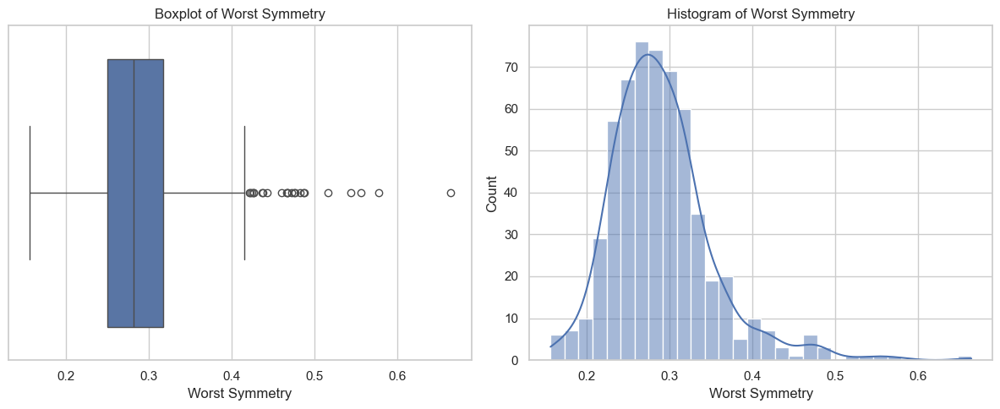

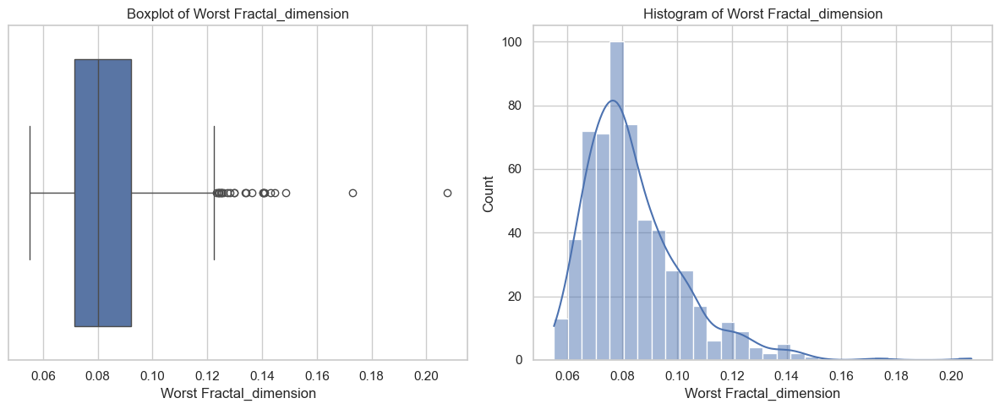

In [69]:
# a) Boxplot and histogram for each numerical variable
for col in numerical_cols:
    plt.figure(figsize=(12, 5))

    # Boxplot
    plt.subplot(1, 2, 1)
    sns.boxplot(data=df, x=col)
    plt.title(f'Boxplot of {col}')

    # Histogram
    plt.subplot(1, 2, 2)
    sns.histplot(df[col], kde=True, bins=30)
    plt.title(f'Histogram of {col}')
    
    plt.tight_layout()
    plt.show()

In [71]:
# b) Comment on distribution shape using skewness & kurtosis
print("\nDistribution summary:")
for col in numerical_cols:
    skewness = df[col].skew()
    kurtosis = df[col].kurt()
    print(f"{col} -> Skewness: {skewness:.2f}, Kurtosis: {kurtosis:.2f}")


Distribution summary:
ID -> Skewness: 6.47, Kurtosis: 42.19
Radius -> Skewness: 0.94, Kurtosis: 0.84
Texture -> Skewness: 0.65, Kurtosis: 0.76
Perimeter -> Skewness: 0.99, Kurtosis: 0.96
Area -> Skewness: 1.64, Kurtosis: 3.65
Smoothness -> Skewness: 0.46, Kurtosis: 0.87
Compactness -> Skewness: 1.19, Kurtosis: 1.65
Concavity -> Skewness: 1.40, Kurtosis: 2.00
Concave points -> Skewness: 1.17, Kurtosis: 1.07
Symmetry -> Skewness: 0.73, Kurtosis: 1.29
Fractal_dimension -> Skewness: 1.30, Kurtosis: 3.01
SE Radius -> Skewness: 3.10, Kurtosis: 17.73
SE Texture -> Skewness: 1.65, Kurtosis: 5.33
SE Perimeter -> Skewness: 3.44, Kurtosis: 21.37
SE Area -> Skewness: 5.45, Kurtosis: 49.21
SE Smoothness -> Skewness: 2.31, Kurtosis: 10.45
SE Compactness -> Skewness: 1.90, Kurtosis: 5.11
SE Concavity -> Skewness: 5.11, Kurtosis: 48.86
SE Concave points -> Skewness: 1.44, Kurtosis: 5.11
SE Symmetry -> Skewness: 2.19, Kurtosis: 7.89
SE Fractal_dimension -> Skewness: 3.92, Kurtosis: 26.28
Worst Radius 

In [77]:
# c) Test for normality (Shapiro-Wilk test and D'Agostino-Pearson)
print("\nNormality Tests (p < 0.05 => not normal):")
for col in numerical_cols:
    shapiro_test = shapiro(df[col])
    dagostino_test = normaltest(df[col])
    print(f"{col} -> Shapiro p = {shapiro_test.pvalue:.4f}, D’Agostino p = {dagostino_test.pvalue:.4f}")


Normality Tests (p < 0.05 => not normal):
ID -> Shapiro p = 0.0000, D’Agostino p = 0.0000
Radius -> Shapiro p = nan, D’Agostino p = nan
Texture -> Shapiro p = 0.0000, D’Agostino p = 0.0000
Perimeter -> Shapiro p = nan, D’Agostino p = nan
Area -> Shapiro p = nan, D’Agostino p = nan
Smoothness -> Shapiro p = nan, D’Agostino p = nan
Compactness -> Shapiro p = 0.0000, D’Agostino p = 0.0000
Concavity -> Shapiro p = 0.0000, D’Agostino p = 0.0000
Concave points -> Shapiro p = nan, D’Agostino p = nan
Symmetry -> Shapiro p = 0.0000, D’Agostino p = 0.0000
Fractal_dimension -> Shapiro p = 0.0000, D’Agostino p = 0.0000
SE Radius -> Shapiro p = nan, D’Agostino p = nan
SE Texture -> Shapiro p = nan, D’Agostino p = nan
SE Perimeter -> Shapiro p = nan, D’Agostino p = nan
SE Area -> Shapiro p = 0.0000, D’Agostino p = 0.0000
SE Smoothness -> Shapiro p = nan, D’Agostino p = nan
SE Compactness -> Shapiro p = 0.0000, D’Agostino p = 0.0000
SE Concavity -> Shapiro p = 0.0000, D’Agostino p = 0.0000
SE Concav

In [79]:
# d) If dependent variable is numerical, categorize it into classes
# Let's assume the last column is the dependent variable
dependent_var = df.columns[-1]

if dependent_var in numerical_cols:
    print(f"\nCategorizing dependent variable '{dependent_var}' into classes:")
    df['Target_Class'] = pd.qcut(df[dependent_var], q=3, labels=['Low', 'Medium', 'High'])
    print(df[['Target_Class']].value_counts())
else:
    print(f"\nDependent variable '{dependent_var}' is already categorical.")


Categorizing dependent variable 'Worst Fractal_dimension' into classes:
Target_Class
Low             190
High            190
Medium          189
Name: count, dtype: int64


In [81]:
# Multivariate Analysis
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as pl

In [83]:
# Identify numerical and categorical columns
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = df.select_dtypes(include=['object']).columns

In [85]:
# a) Pairplot for numerical variables
print("Generating pairplot for numerical variables (this might take time)...")
sns.pairplot(df[numerical_cols])
plt.suptitle("Pairplot of Numerical Variables", y=1.02)
plt.show()

Generating pairplot for numerical variables (this might take time)...


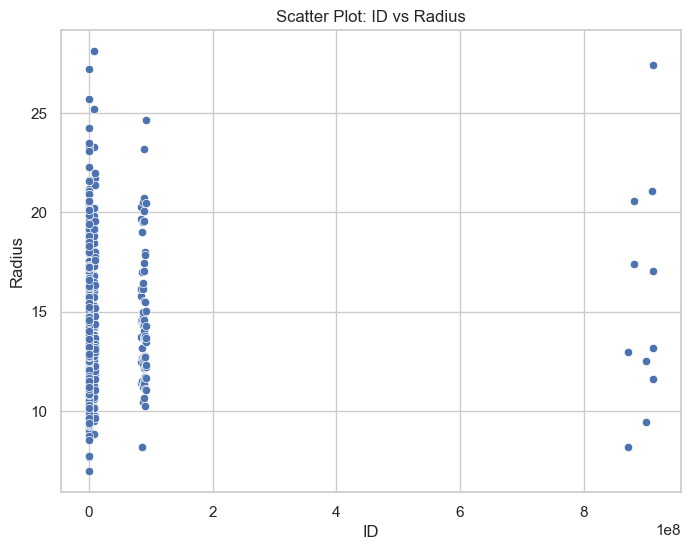

In [87]:
# a) Scatter Plot for two key variables
# Pick two example columns, or choose based on your data
if len(numerical_cols) >= 2:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=df, x=numerical_cols[0], y=numerical_cols[1])
    plt.title(f'Scatter Plot: {numerical_cols[0]} vs {numerical_cols[1]}')
    plt.show()

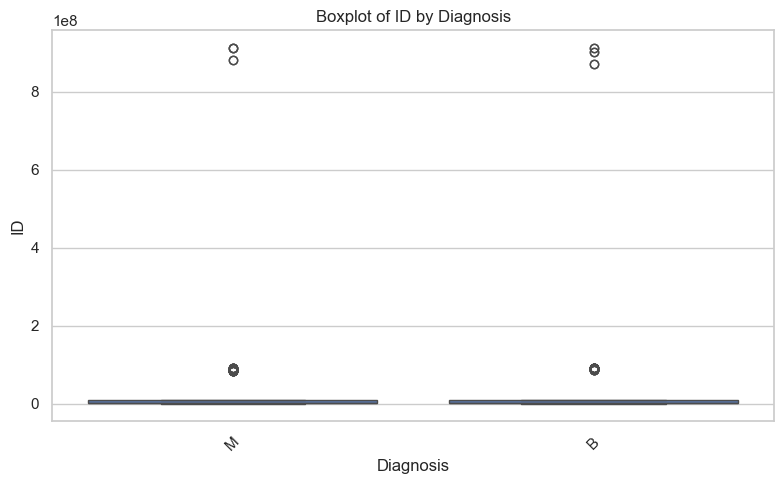

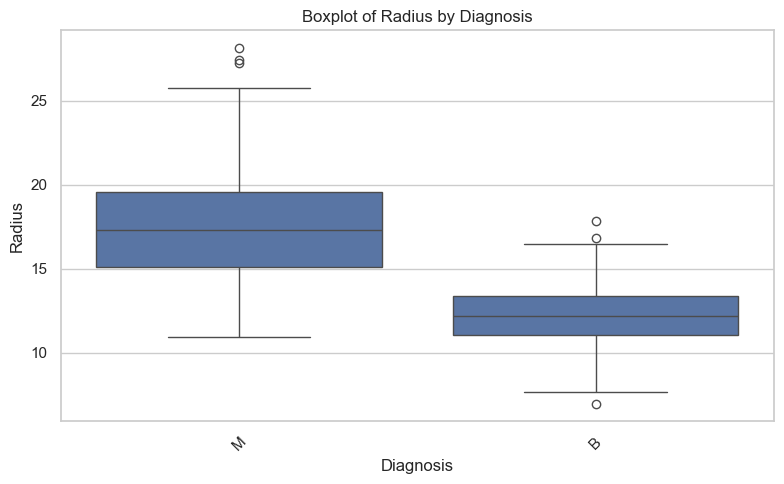

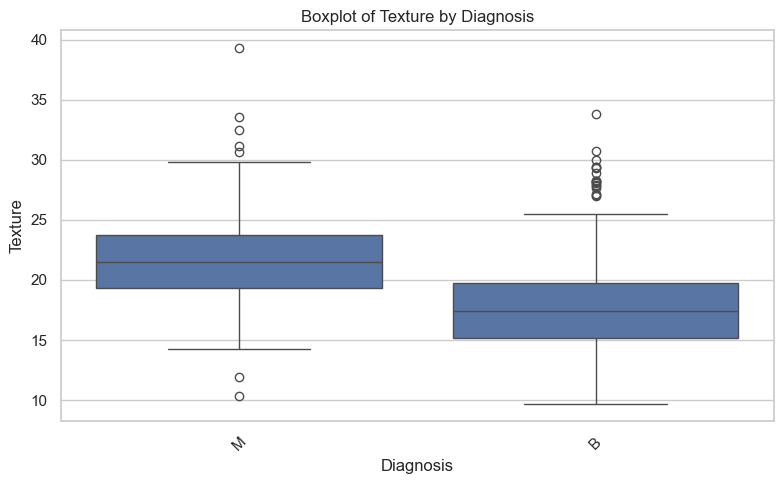

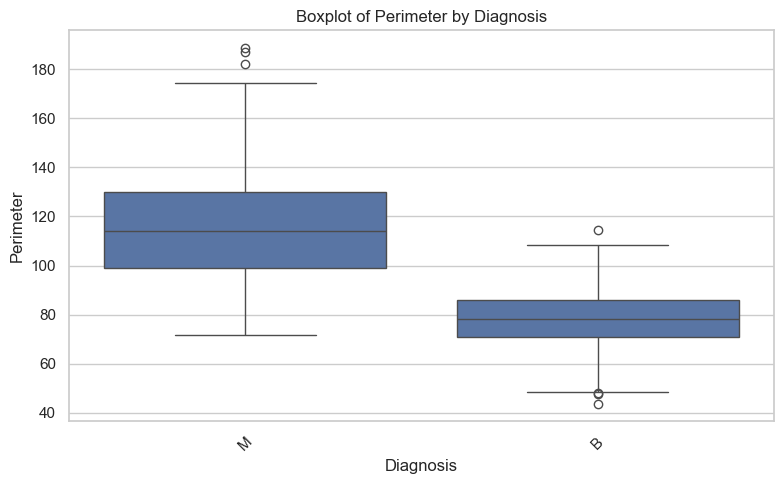

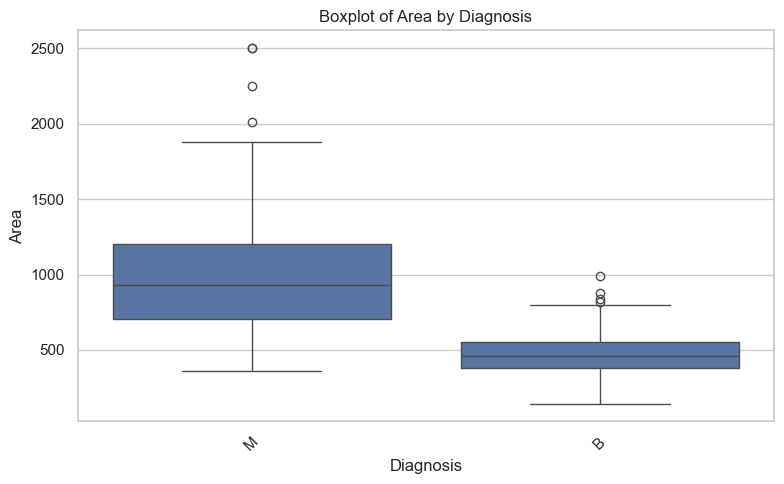

...

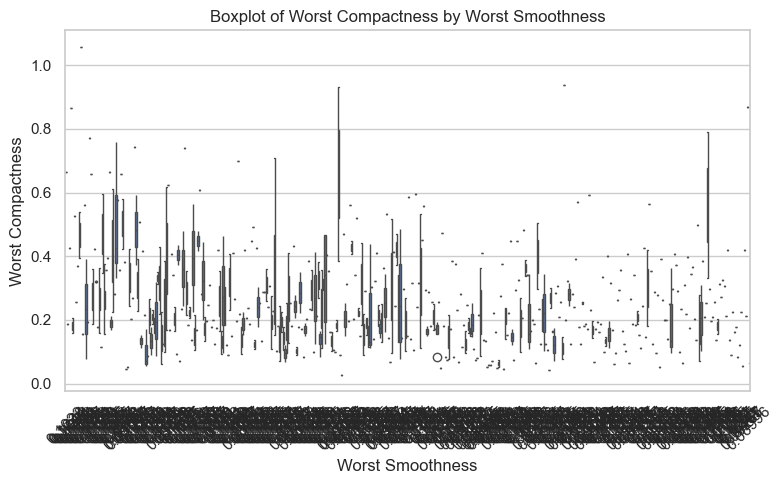

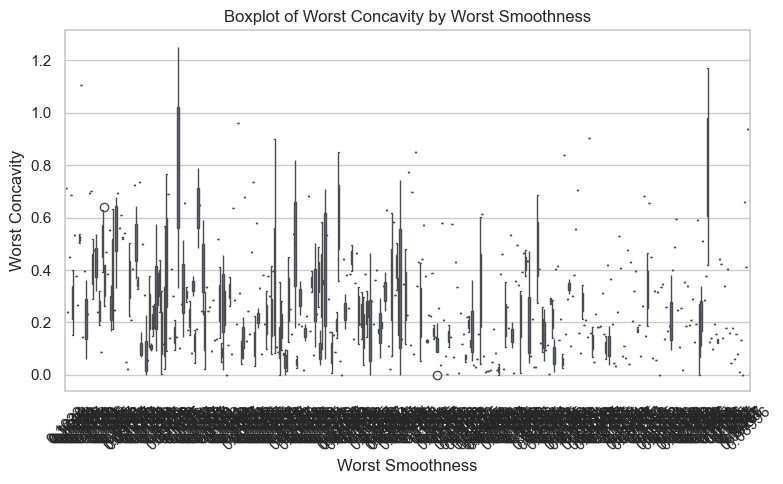

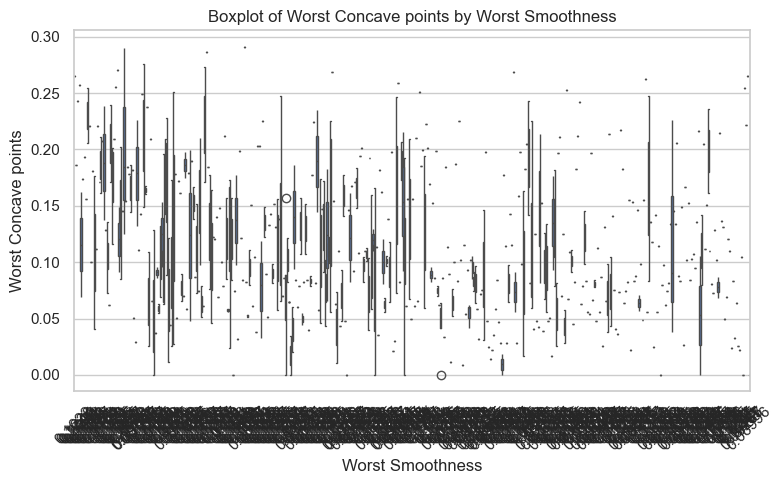

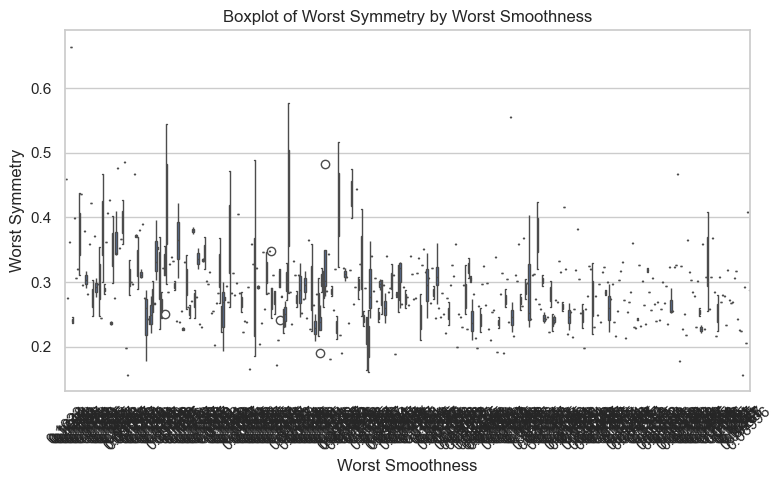

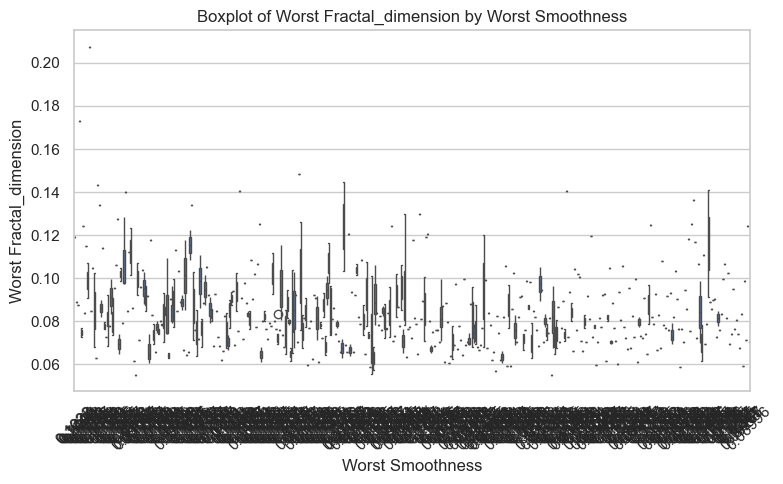

In [89]:
# a) Boxplot: Numerical vs Categorical 
# If there’s at least one categorical variable and one numerical
if categorical_cols.any():
    for cat in categorical_cols:
        for num in numerical_cols:
            plt.figure(figsize=(8, 5))
            sns.boxplot(data=df, x=cat, y=num)
            plt.title(f'Boxplot of {num} by {cat}')
            plt.xticks(rotation=45)
            plt.tight_layout()
            plt.show()

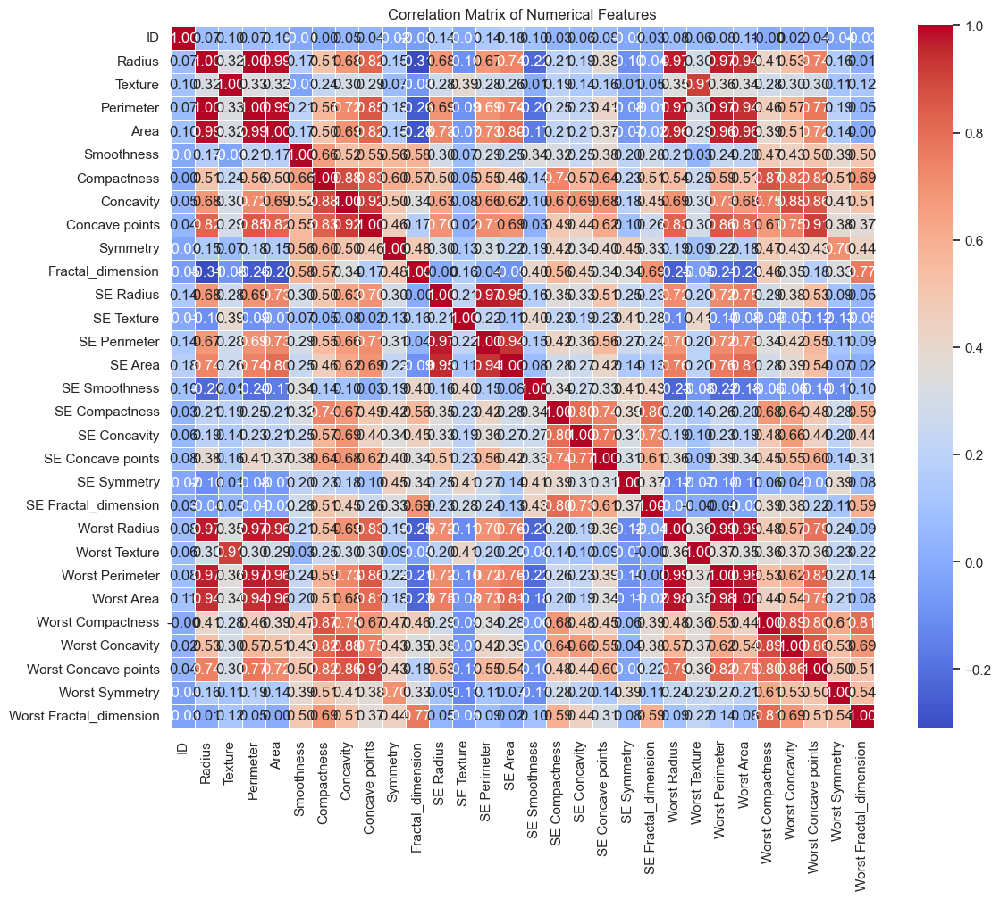

In [90]:
# b) Correlation Matrix 
corr_matrix = df[numerical_cols].corr()

plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True, linewidths=0.5)
plt.title("Correlation Matrix of Numerical Features")
plt.tight_layout()
plt.show()

In [ ]:
# 5. Opinion on Dataset

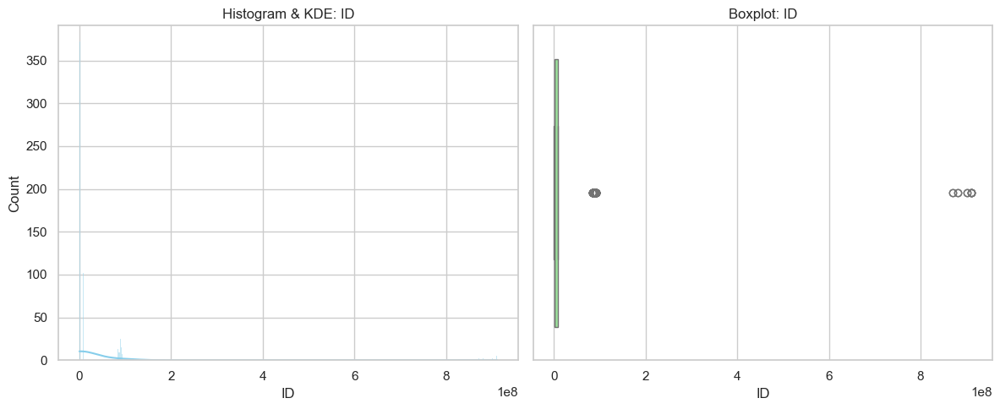


Normality Tests for ID:
Shapiro-Wilk: 9.523535031553533e-43
D’Agostino’s K^2: 6.024969934236633e-150
Anderson-Darling: 154.6088089895261


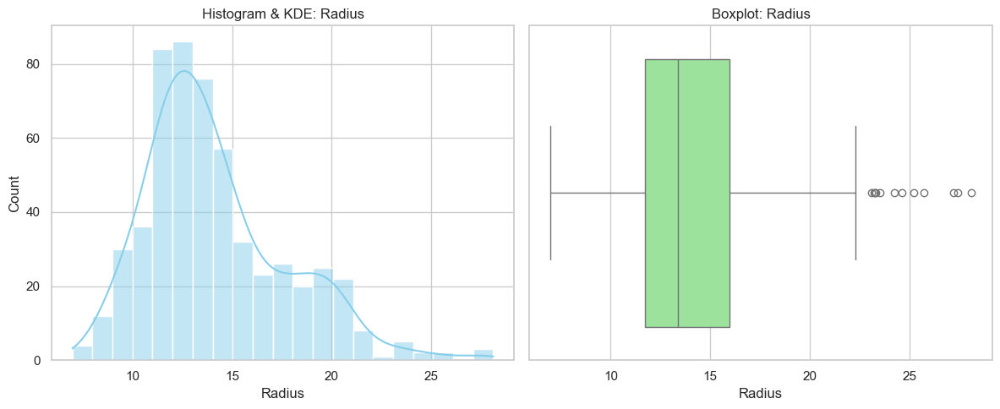


Normality Tests for Radius:
Shapiro-Wilk: 7.329403950511721e-14
D’Agostino’s K^2: 4.1917634410995773e-16
Anderson-Darling: 10.27508476052526


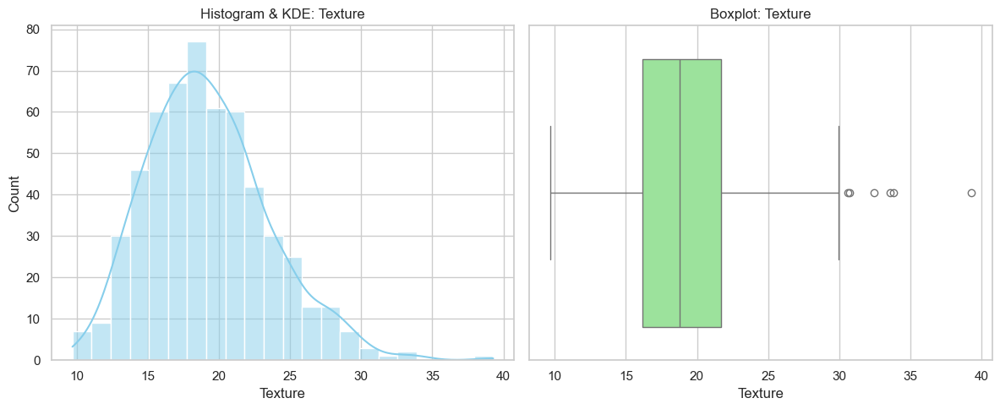


Normality Tests for Texture:
Shapiro-Wilk: 1.0856282570899113e-07
D’Agostino’s K^2: 7.567508446204402e-10
Anderson-Darling: 2.4263858844043398


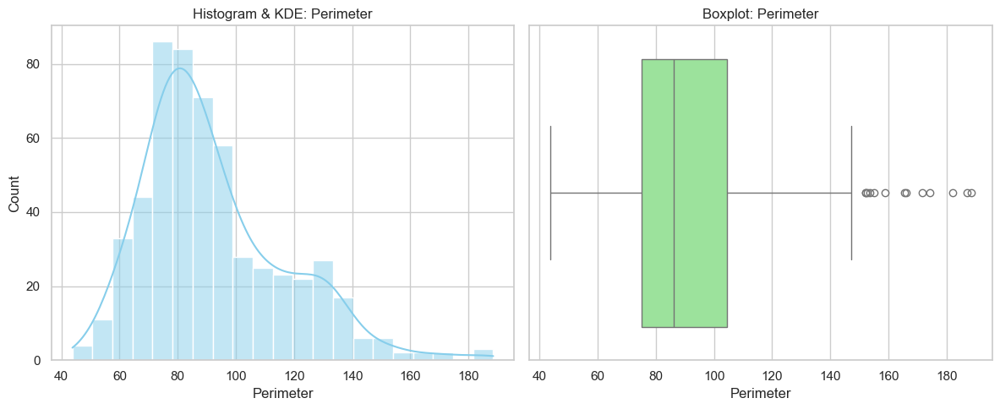


Normality Tests for Perimeter:
Shapiro-Wilk: 1.6272173035575677e-14
D’Agostino’s K^2: 1.229044401262794e-17
Anderson-Darling: 10.934652745952235


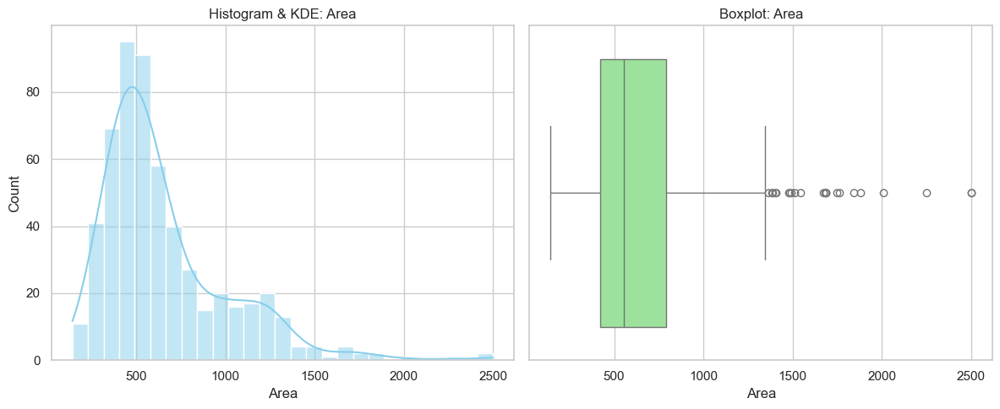


Normality Tests for Area:
Shapiro-Wilk: 7.402570940451096e-22
D’Agostino’s K^2: 1.9011845615505923e-41
Anderson-Darling: 22.498851388255616


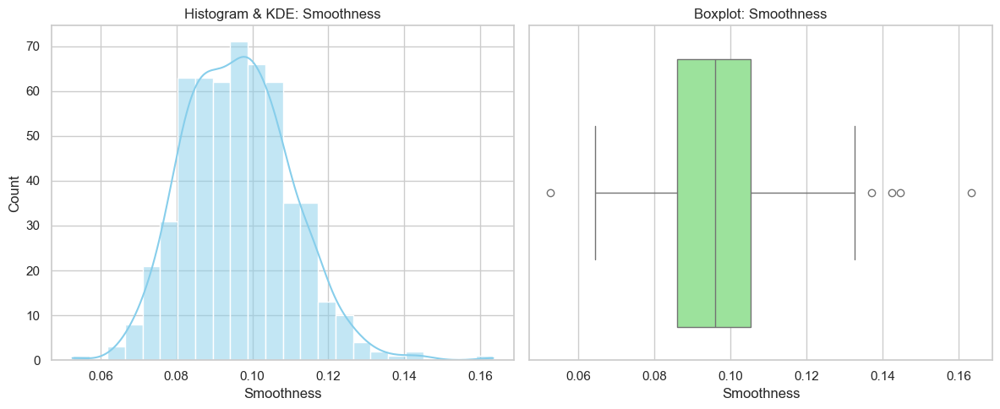


Normality Tests for Smoothness:
Shapiro-Wilk: 0.00010641916770717954
D’Agostino’s K^2: 2.4402120564379415e-06
Anderson-Darling: 0.9250785344140695


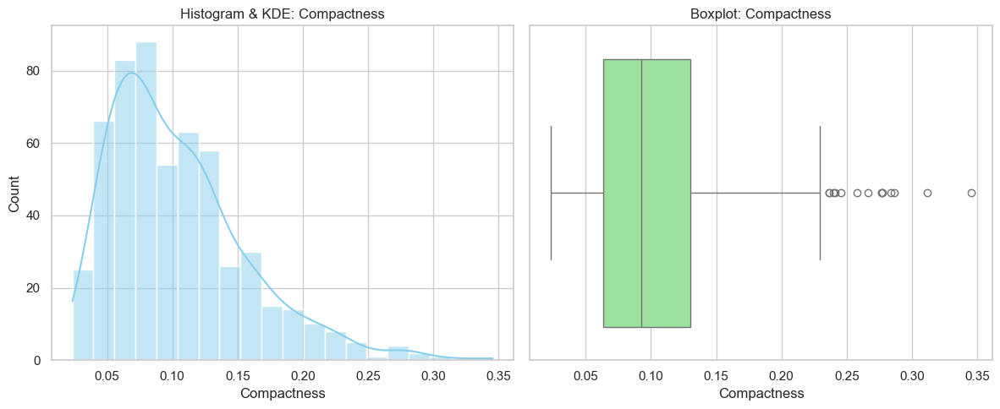


Normality Tests for Compactness:
Shapiro-Wilk: 7.919454322871042e-17
D’Agostino’s K^2: 2.500437225615577e-24
Anderson-Darling: 11.009956813218423


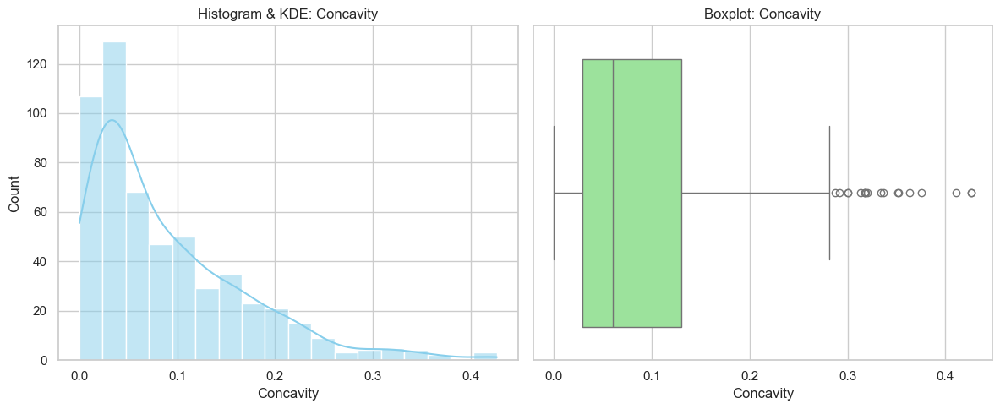


Normality Tests for Concavity:
Shapiro-Wilk: 1.9123608475989464e-21
D’Agostino’s K^2: 3.346848642898636e-31
Anderson-Darling: 21.27786503565312


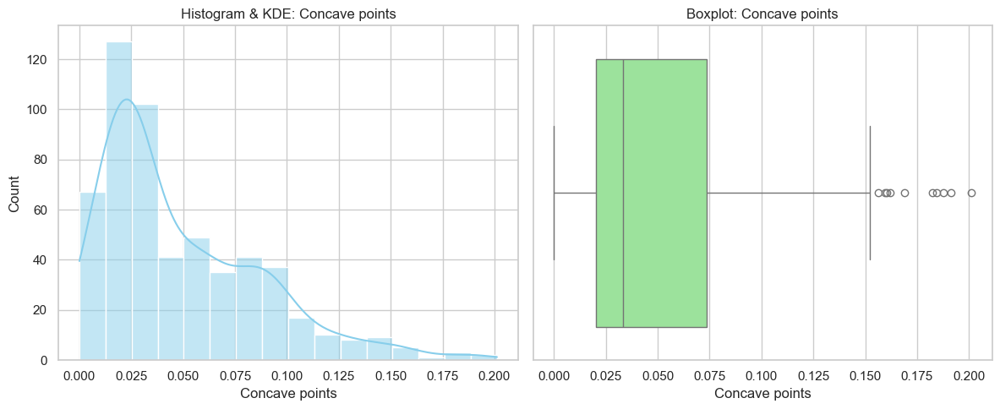


Normality Tests for Concave points:
Shapiro-Wilk: 2.3380102633716344e-19
D’Agostino’s K^2: 1.4607501758706839e-22
Anderson-Darling: 18.722189529601565


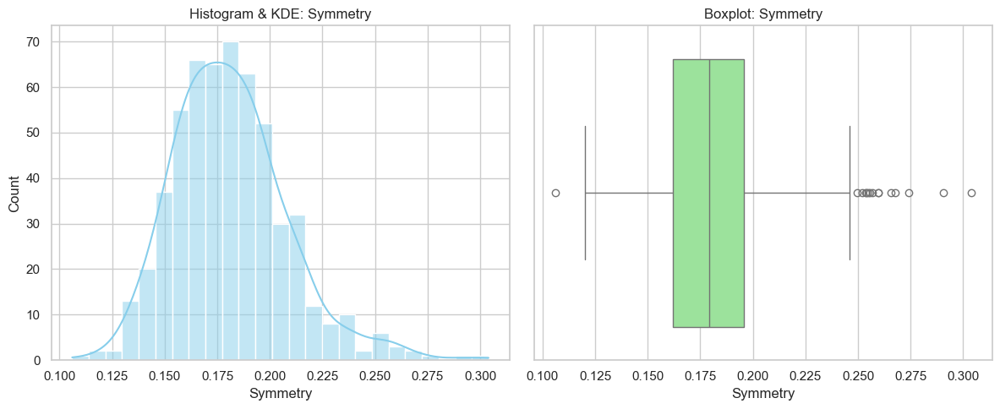


Normality Tests for Symmetry:
Shapiro-Wilk: 3.140692806496557e-09
D’Agostino’s K^2: 2.013925639635993e-14
Anderson-Darling: 3.0814988321640158


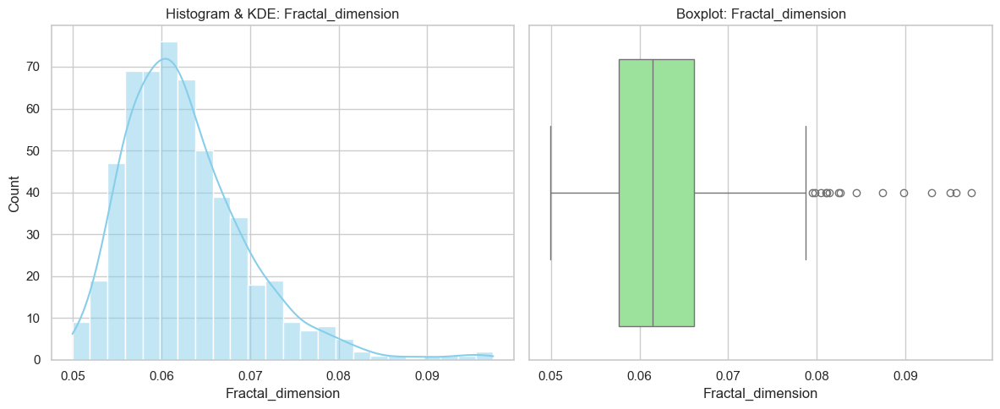


Normality Tests for Fractal_dimension:
Shapiro-Wilk: 1.736655999090278e-16
D’Agostino’s K^2: 1.0540172983646224e-32
Anderson-Darling: 8.628787192786149


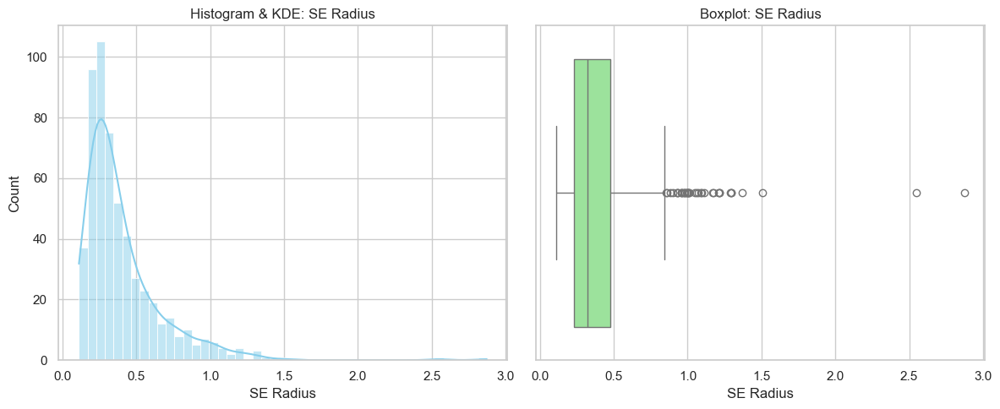


Normality Tests for SE Radius:
Shapiro-Wilk: 2.0654089202466577e-28
D’Agostino’s K^2: 7.363913781274274e-91
Anderson-Darling: 32.805944128402416


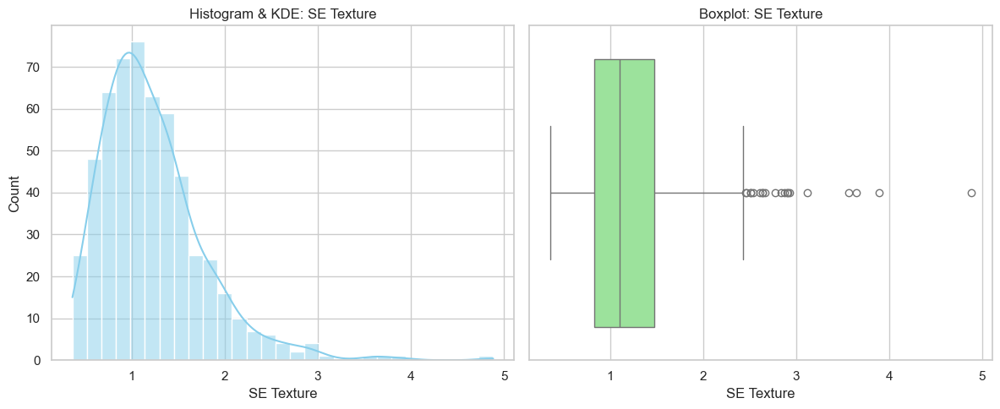


Normality Tests for SE Texture:
Shapiro-Wilk: 6.773996576604196e-19
D’Agostino’s K^2: 5.4907085371065705e-45
Anderson-Darling: 10.304109342541665


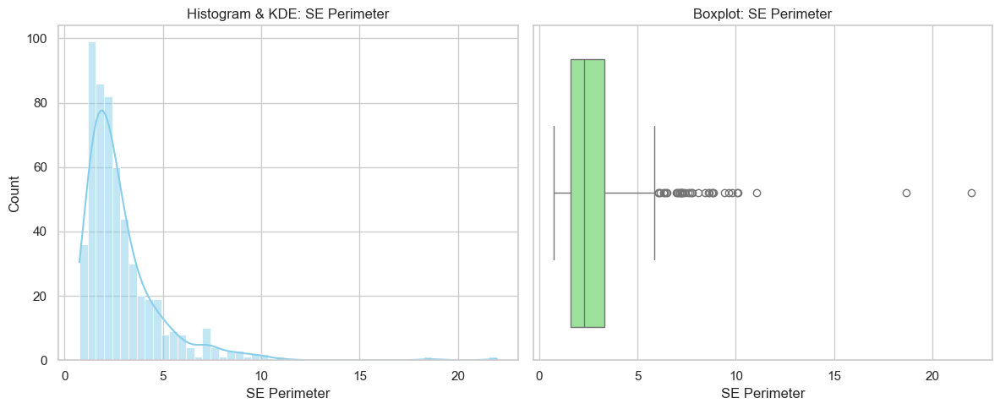


Normality Tests for SE Perimeter:
Shapiro-Wilk: 1.3845127940915354e-29
D’Agostino’s K^2: 1.7740322498595412e-99
Anderson-Darling: 35.290016470054525


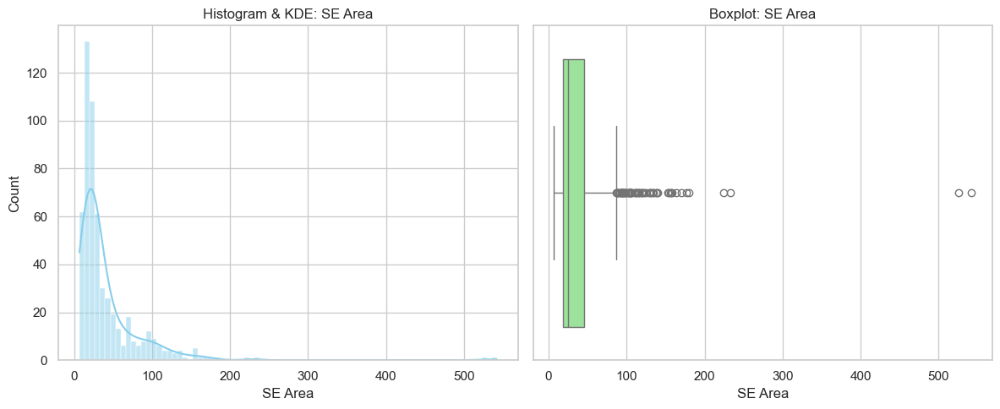


Normality Tests for SE Area:
Shapiro-Wilk: 5.414805712052318e-35
D’Agostino’s K^2: 1.3845635374284288e-141
Anderson-Darling: 58.6902319659938


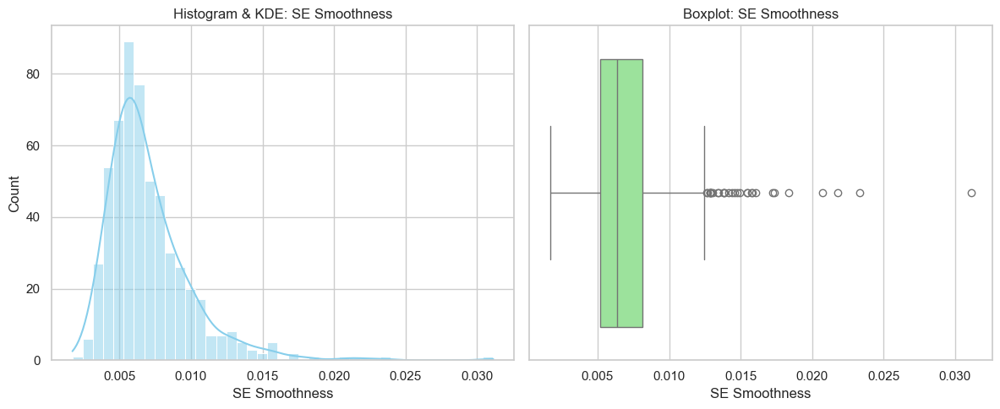


Normality Tests for SE Smoothness:
Shapiro-Wilk: 1.9044200092561025e-23
D’Agostino’s K^2: 2.3166072326722254e-68
Anderson-Darling: 17.867021253798043


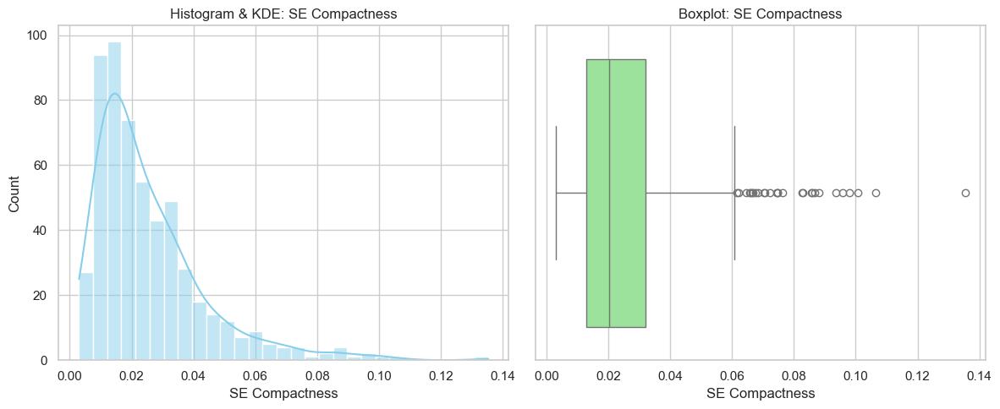


Normality Tests for SE Compactness:
Shapiro-Wilk: 1.17818227129909e-23
D’Agostino’s K^2: 6.638139782337456e-51
Anderson-Darling: 23.036037496230165


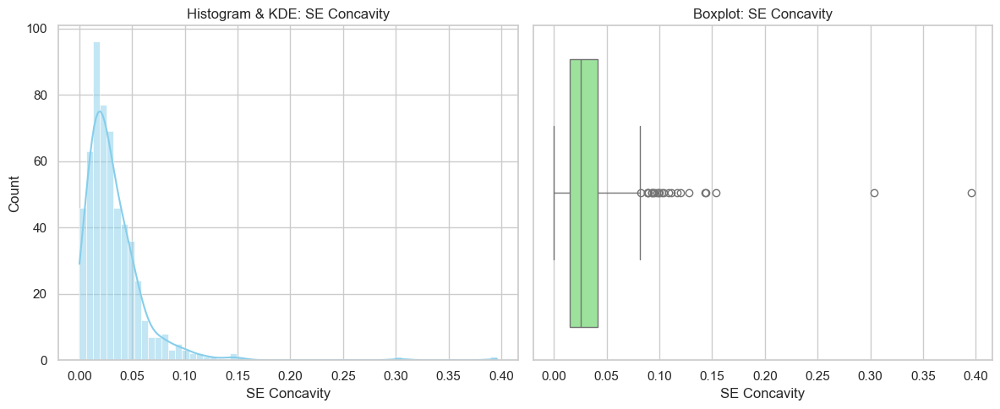


Normality Tests for SE Concavity:
Shapiro-Wilk: 2.0075968508079283e-31
D’Agostino’s K^2: 2.8474218600644454e-135
Anderson-Darling: 28.895781926317113


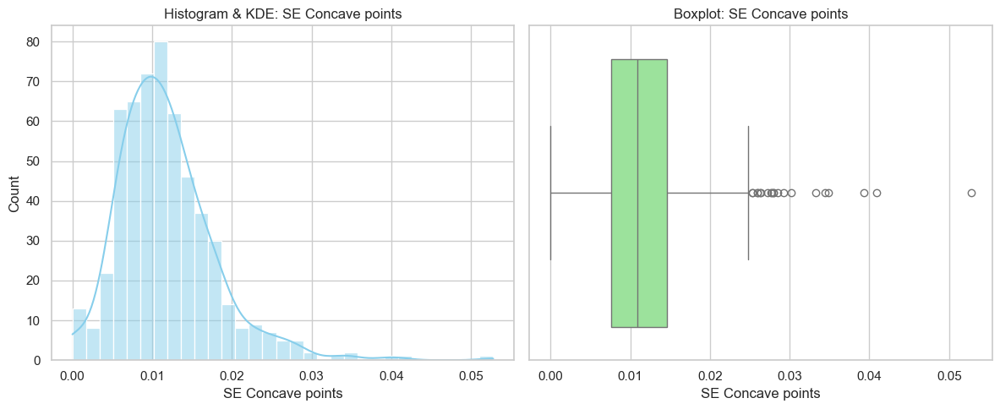


Normality Tests for SE Concave points:
Shapiro-Wilk: 6.537097791267414e-17
D’Agostino’s K^2: 3.060366329736881e-41
Anderson-Darling: 7.994085184830396


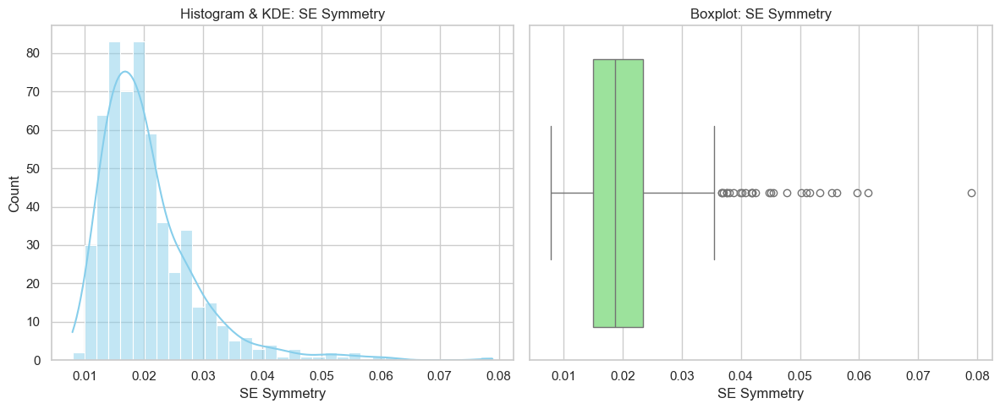


Normality Tests for SE Symmetry:
Shapiro-Wilk: 5.688378161162379e-24
D’Agostino’s K^2: 5.4240378763180744e-62
Anderson-Darling: 20.651019856954576


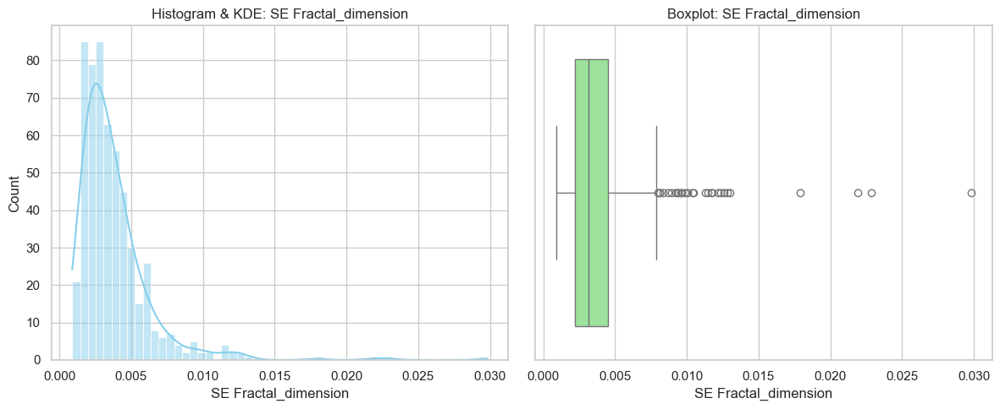


Normality Tests for SE Fractal_dimension:
Shapiro-Wilk: 1.2813519400670764e-30
D’Agostino’s K^2: 2.7831439631345877e-110
Anderson-Darling: 33.16596822279814


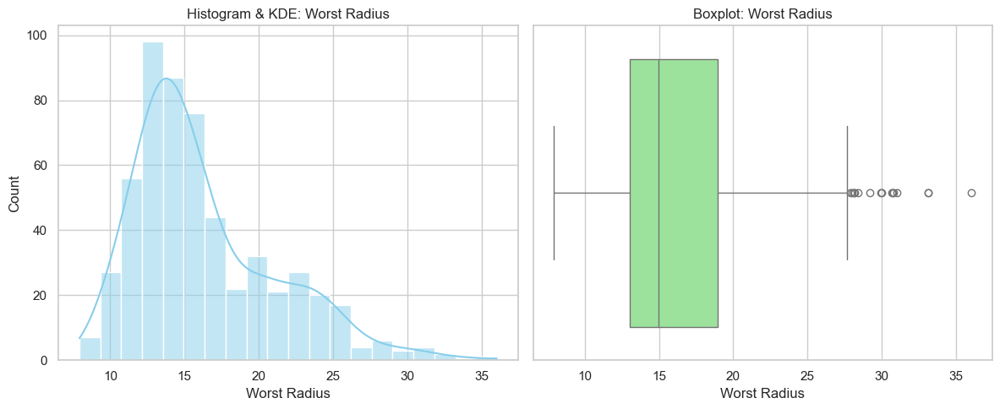


Normality Tests for Worst Radius:
Shapiro-Wilk: 6.666290876147371e-17
D’Agostino’s K^2: 3.9083112162786956e-19
Anderson-Darling: 15.53144522059938


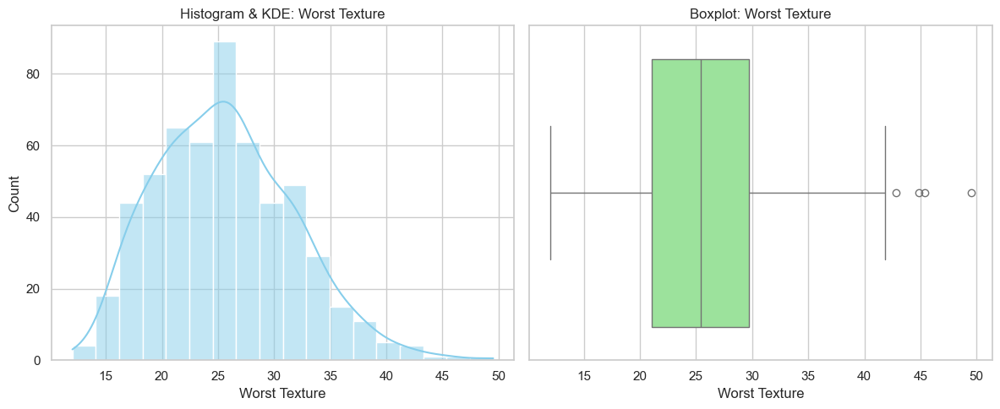


Normality Tests for Worst Texture:
Shapiro-Wilk: 1.1130242004306682e-05
D’Agostino’s K^2: 0.00010259520129751189
Anderson-Darling: 1.5616575835218782


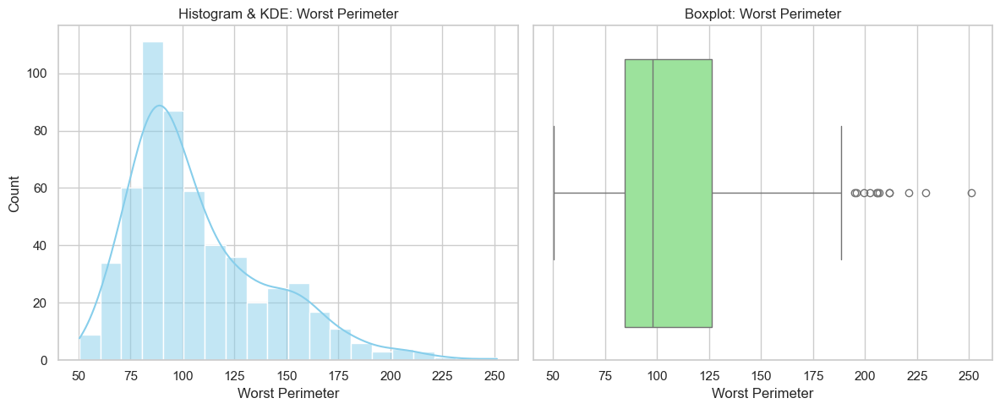


Normality Tests for Worst Perimeter:
Shapiro-Wilk: 5.097017003529252e-17
D’Agostino’s K^2: 2.0283971006319106e-20
Anderson-Darling: 15.097490729935316


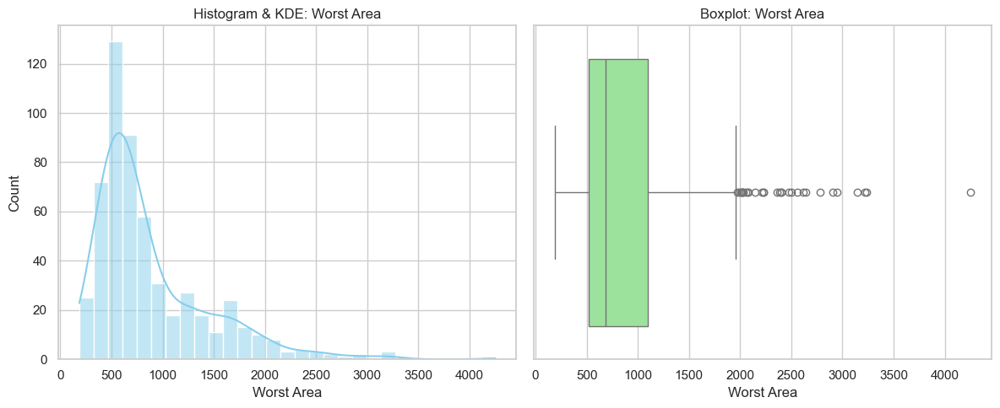


Normality Tests for Worst Area:
Shapiro-Wilk: 2.9054139057194326e-24
D’Agostino’s K^2: 3.0456386752459305e-46
Anderson-Darling: 30.371092523665766


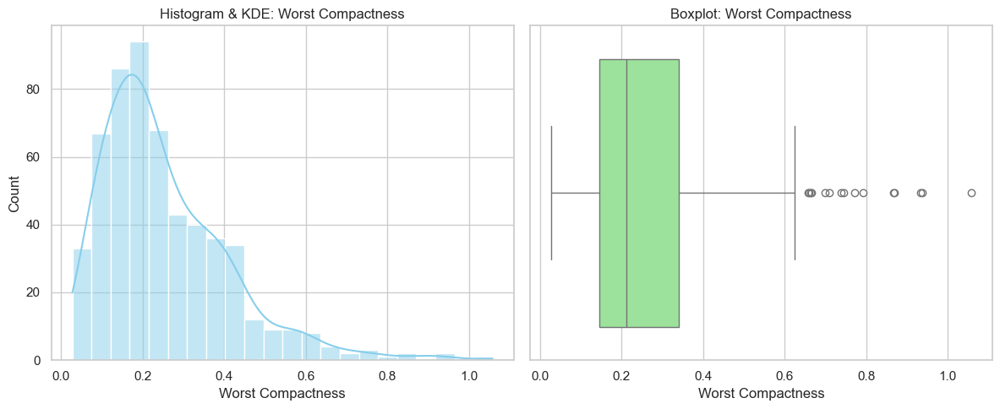


Normality Tests for Worst Compactness:
Shapiro-Wilk: 2.378581162826706e-19
D’Agostino’s K^2: 1.1616602947198843e-35
Anderson-Darling: 13.863345862575443


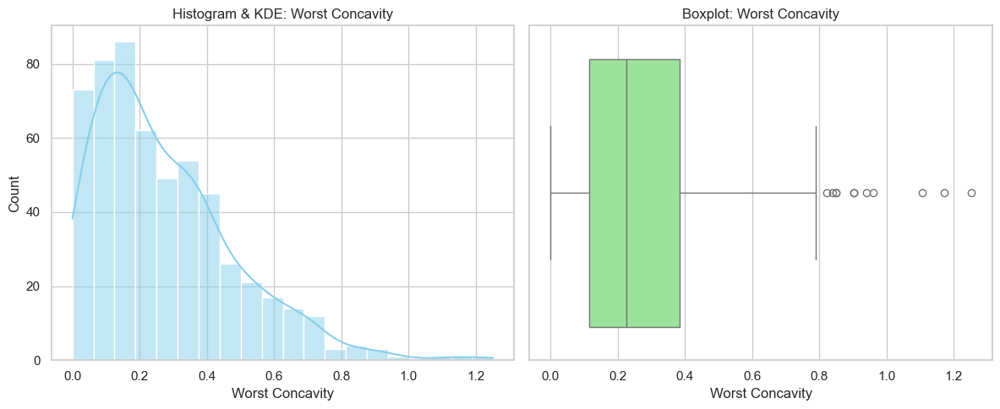


Normality Tests for Worst Concavity:
Shapiro-Wilk: 5.766454662519657e-17
D’Agostino’s K^2: 5.838100451045111e-24
Anderson-Darling: 10.981213300251738


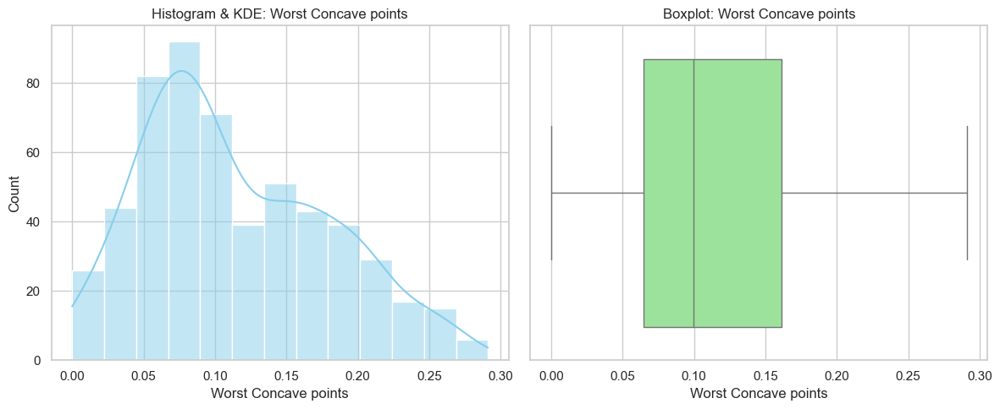


Normality Tests for Worst Concave points:
Shapiro-Wilk: 2.5492295167880725e-10
D’Agostino’s K^2: 3.969383925885677e-08
Anderson-Darling: 6.620492237188046


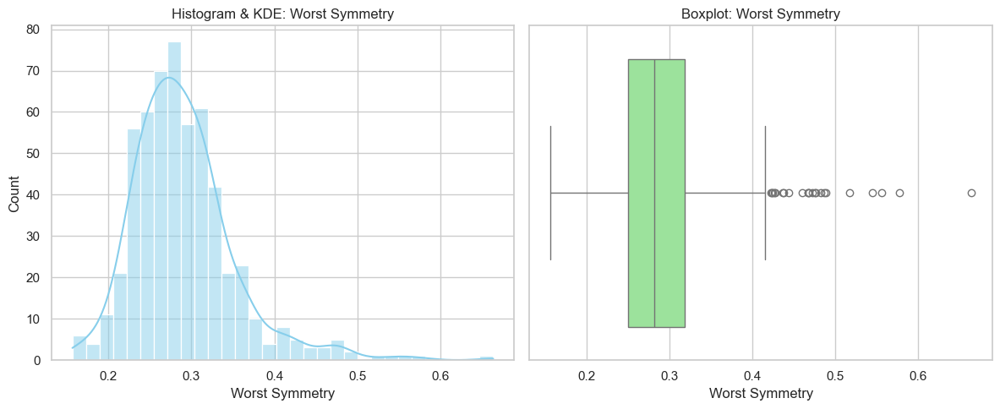


Normality Tests for Worst Symmetry:
Shapiro-Wilk: 4.4151637849926034e-17
D’Agostino’s K^2: 6.52214666319102e-39
Anderson-Darling: 9.003572448353907


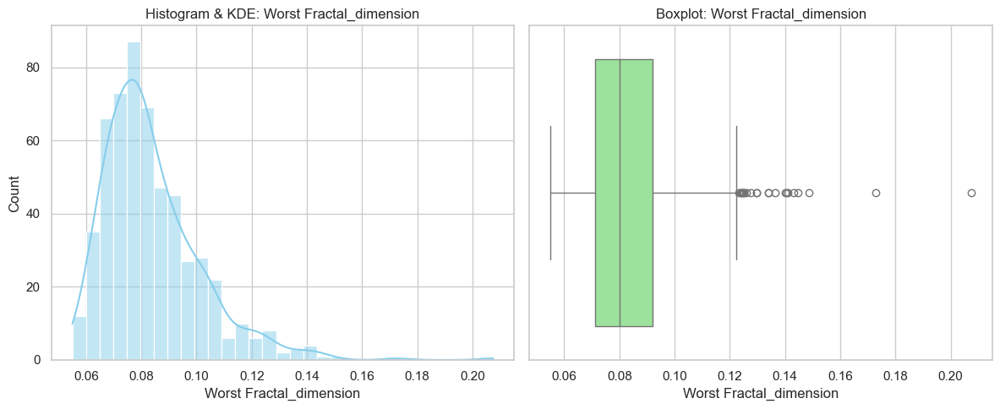


Normality Tests for Worst Fractal_dimension:
Shapiro-Wilk: 1.943801208783527e-19
D’Agostino’s K^2: 1.4474456815025148e-46
Anderson-Darling: 12.56707534916859


In [99]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import shapiro, normaltest, anderson

# Assume df is your cleaned DataFrame
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = df.select_dtypes(include=['object', 'category']).columns

# Univariate Visuals and Normality Test
for col in numerical_cols:
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    sns.histplot(df[col], kde=True, ax=axes[0], color='skyblue')
    sns.boxplot(x=df[col], ax=axes[1], color='lightgreen')
    axes[0].set_title(f'Histogram & KDE: {col}')
    axes[1].set_title(f'Boxplot: {col}')
    plt.tight_layout()
    plt.show()

    # Normality Tests
    print(f"\nNormality Tests for {col}:")
    print("Shapiro-Wilk:", shapiro(df[col])[1])
    print("D’Agostino’s K^2:", normaltest(df[col])[1])
    print("Anderson-Darling:", anderson(df[col]).statistic)

In [101]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Load the dataset
df = pd.read_csv('Breast_Cancer_Wisconsin_Assignment.csv')

# Step 2: Drop ID column and any unnamed columns
df = df.drop(columns=['id'], errors='ignore')
df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

# Step 3: Encode diagnosis column ('M' = 1, 'B' = 0)
df['diagnosis'] = df['diagnosis'].map({'M': 1, 'B': 0})

# Step 4: Compute correlation with the target
correlation = df.corr()['diagnosis'].drop('diagnosis').sort_values(ascending=False)

# Step 5: Display top 5 correlated features
print("Top 5 features most correlated with diagnosis:\n")
print(correlation.head(5))

# Optional: Visualize correlation heatmap for these features
top5_features = correlation.head(5).index.tolist()
sns.heatmap(df[top5_features + ['diagnosis']].corr(), annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap of Top 5 Features with Diagnosis")
plt.show()


KeyError: 'diagnosis'

KeyError: 'target_class'

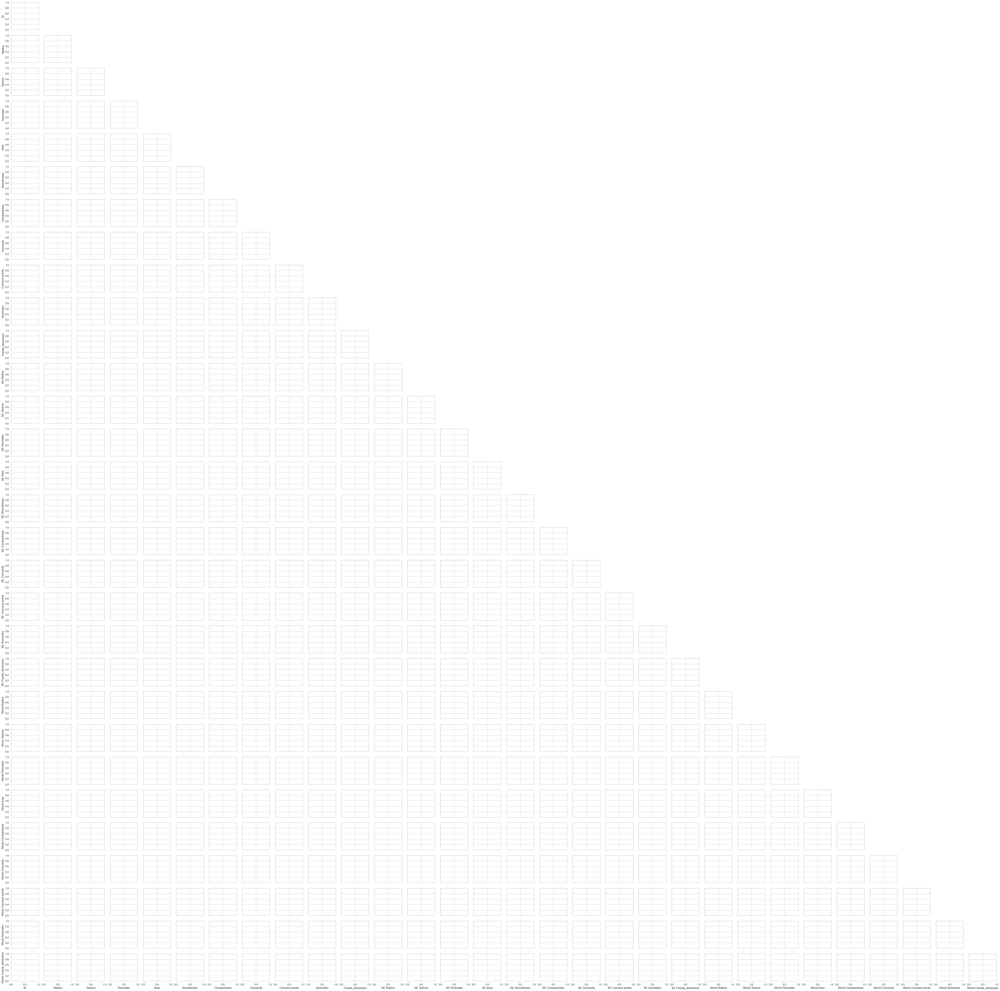

In [103]:
# Pairplot (uses hue if target is categorical)
sns.pairplot(df, hue='target_class', corner=True)
plt.suptitle('Pairplot: Multivariate Relationships', y=1.02)
plt.show()

# Scatter and Boxplot combinations
for col in numerical_cols:
    if col != 'target_var':
        plt.figure(figsize=(6, 4))
        sns.scatterplot(data=df, x=col, y='target_var')
        plt.title(f'Scatterplot: {col} vs Target')
        plt.show()

        if 'target_class' in df.columns:
            plt.figure(figsize=(6, 4))
            sns.boxplot(data=df, x='target_class', y=col)
            plt.title(f'Boxplot: {col} across Target Classes')
            plt.show()

# Correlation Matrix
plt.figure(figsize=(10, 8))
corr = df[numerical_cols].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', center=0, fmt=".2f")
plt.title('Correlation Matrix')
plt.show()


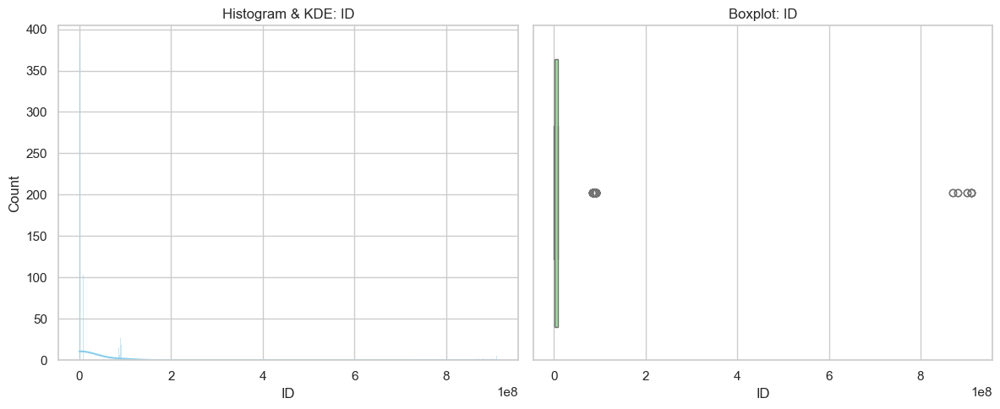


Normality Tests for ID:
Shapiro-Wilk: 3.0744499255777833e-43
D’Agostino’s K^2: 4.1561485584593205e-155
Anderson-Darling: 158.9885529331143


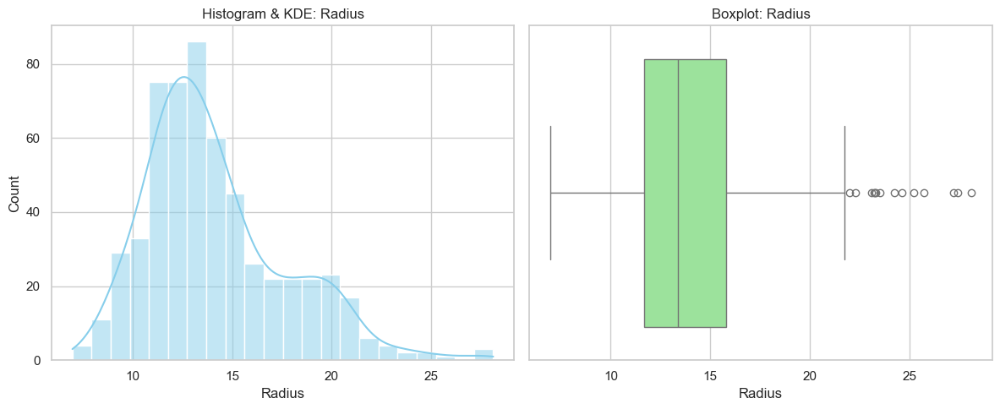


Normality Tests for Radius:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


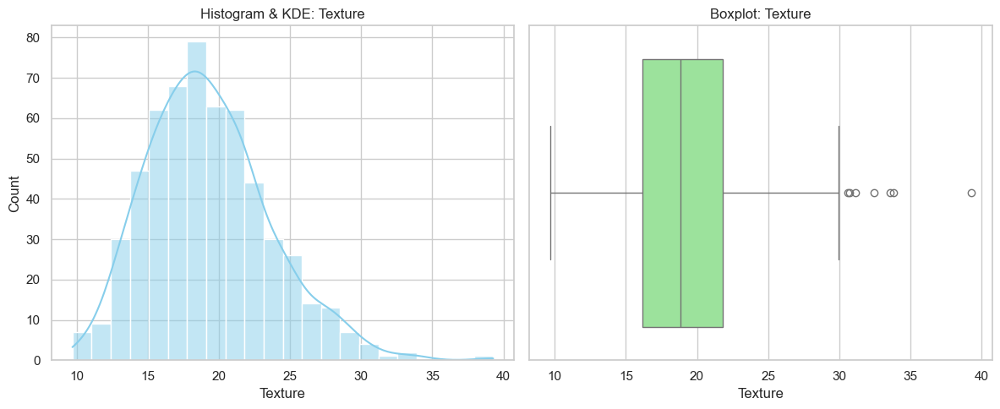


Normality Tests for Texture:
Shapiro-Wilk: 7.283580702733753e-08
D’Agostino’s K^2: 4.685882796961145e-10
Anderson-Darling: 2.5528180484524228


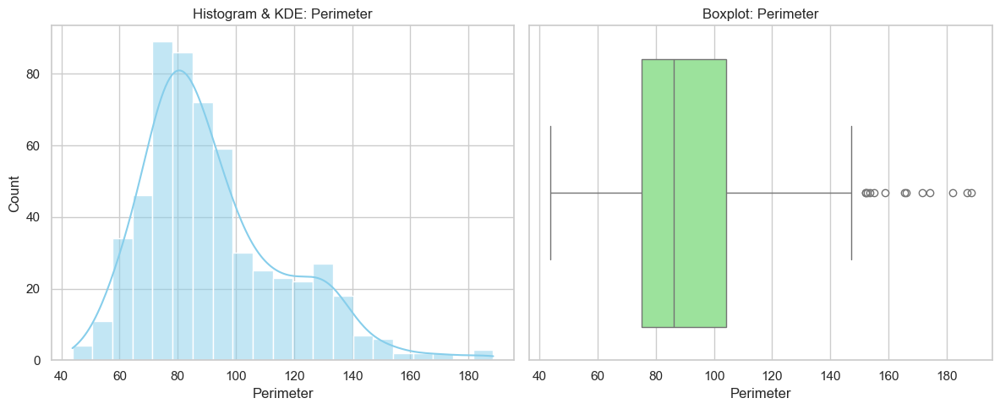


Normality Tests for Perimeter:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


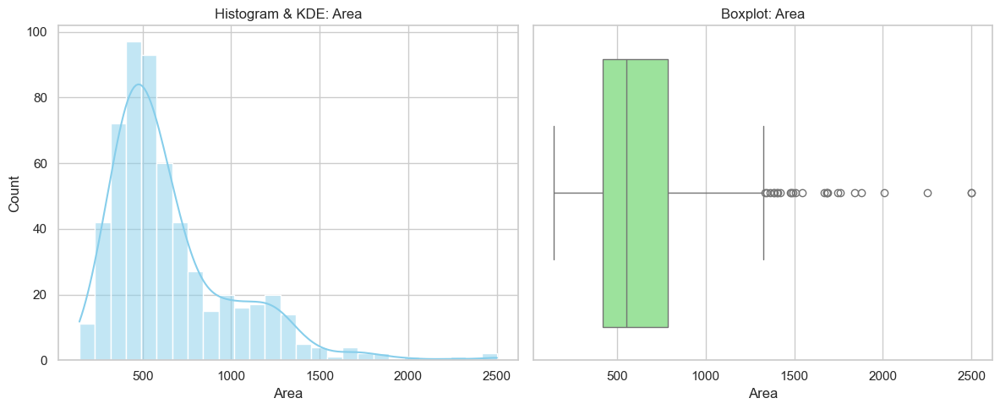


Normality Tests for Area:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


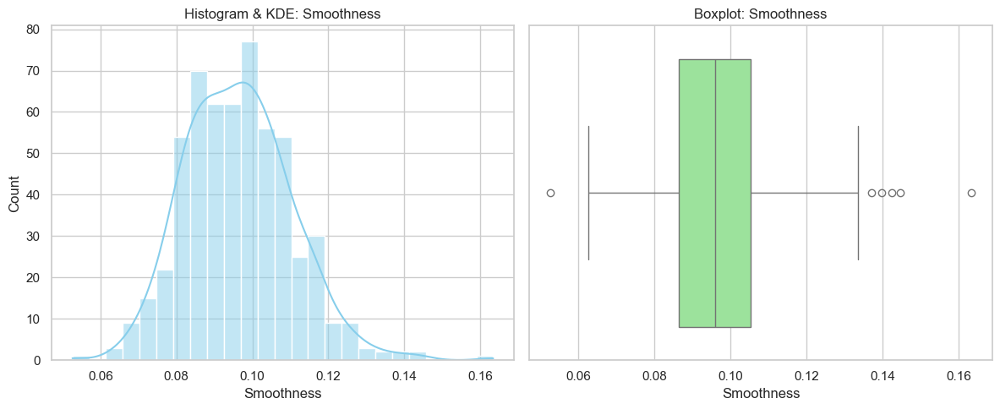


Normality Tests for Smoothness:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


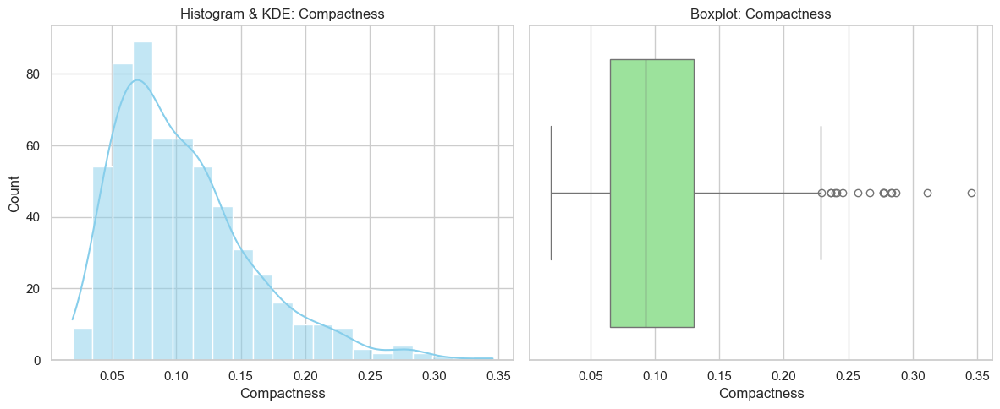


Normality Tests for Compactness:
Shapiro-Wilk: 3.96720387509556e-17
D’Agostino’s K^2: 2.7333433490329536e-25
Anderson-Darling: 11.500271178848834


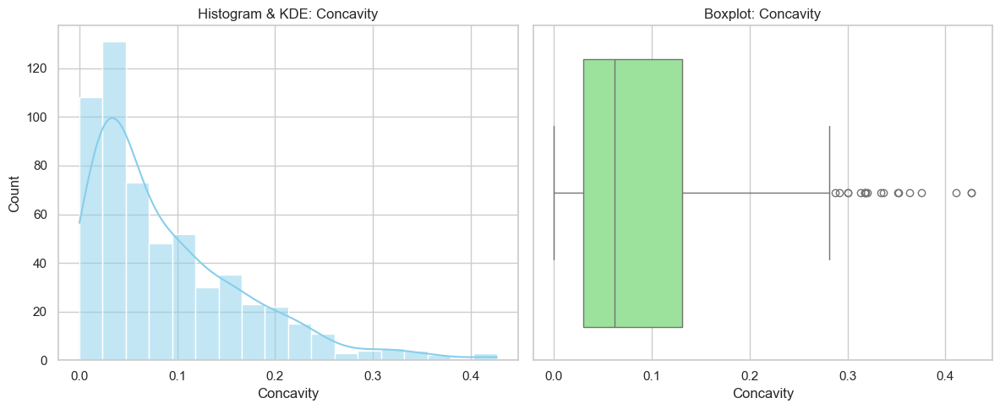


Normality Tests for Concavity:
Shapiro-Wilk: 1.3385710043588943e-21
D’Agostino’s K^2: 1.8706515779247436e-31
Anderson-Darling: 21.662255184920696


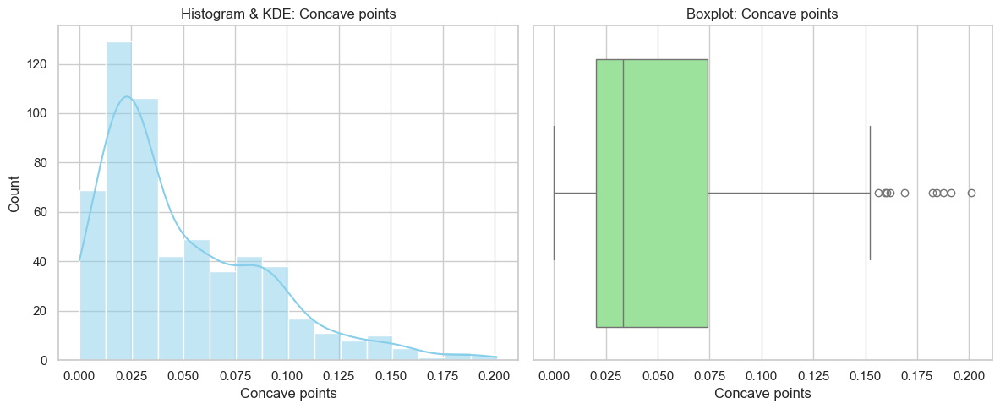


Normality Tests for Concave points:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


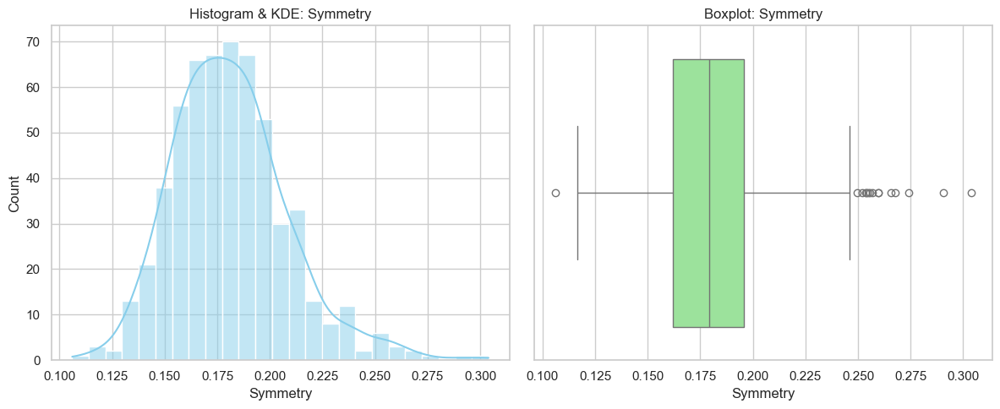


Normality Tests for Symmetry:
Shapiro-Wilk: 7.884771871025335e-09
D’Agostino’s K^2: 1.5898397363101805e-13
Anderson-Darling: 2.9812080188036134


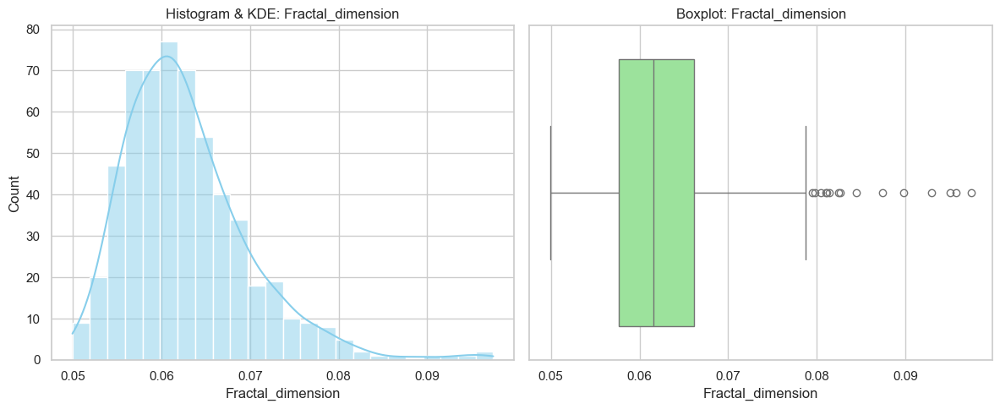


Normality Tests for Fractal_dimension:
Shapiro-Wilk: 1.956574680305863e-16
D’Agostino’s K^2: 1.4280298636963606e-32
Anderson-Darling: 8.58403534184049


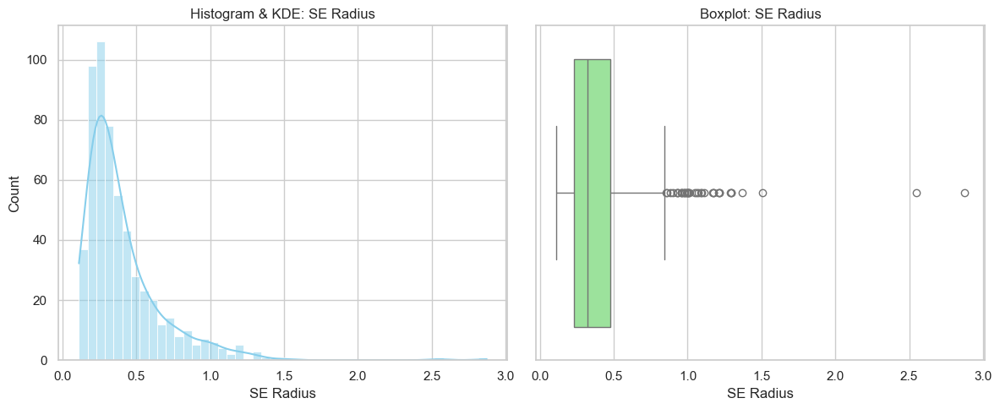


Normality Tests for SE Radius:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


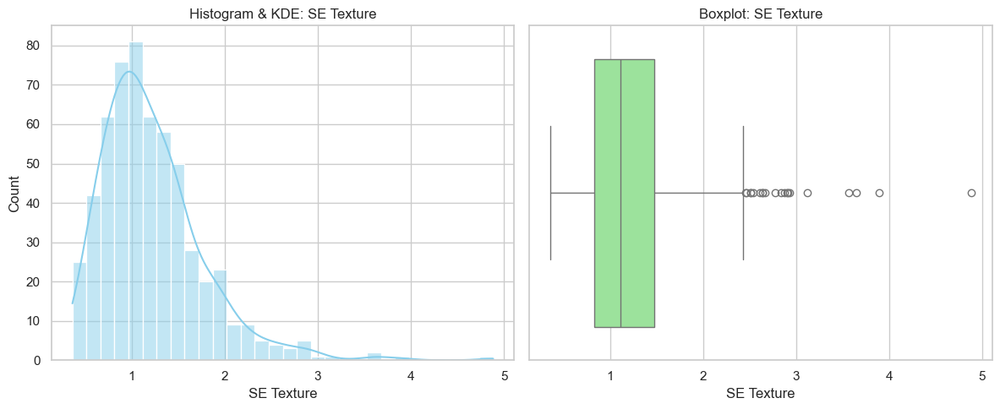


Normality Tests for SE Texture:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


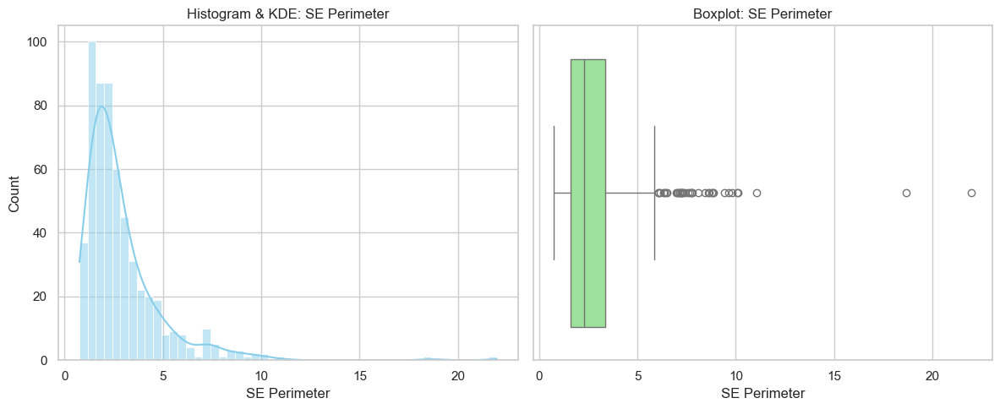


Normality Tests for SE Perimeter:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


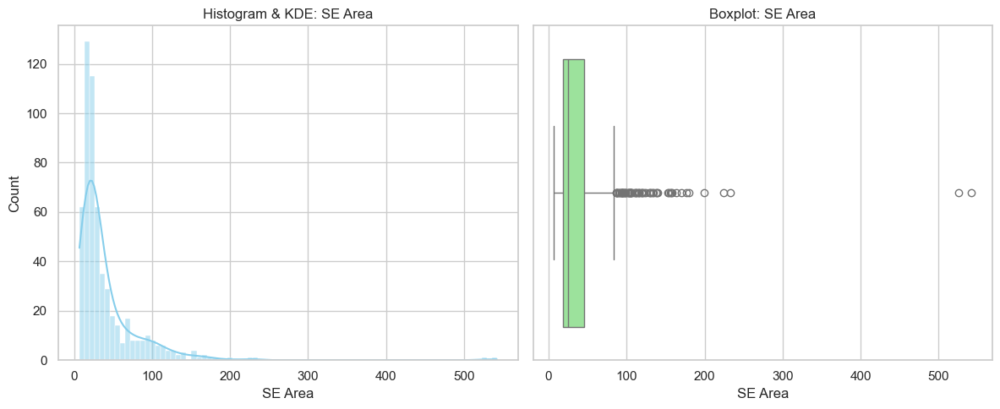


Normality Tests for SE Area:
Shapiro-Wilk: 2.652702990292784e-35
D’Agostino’s K^2: 8.777570438431168e-144
Anderson-Darling: 60.461854506440204


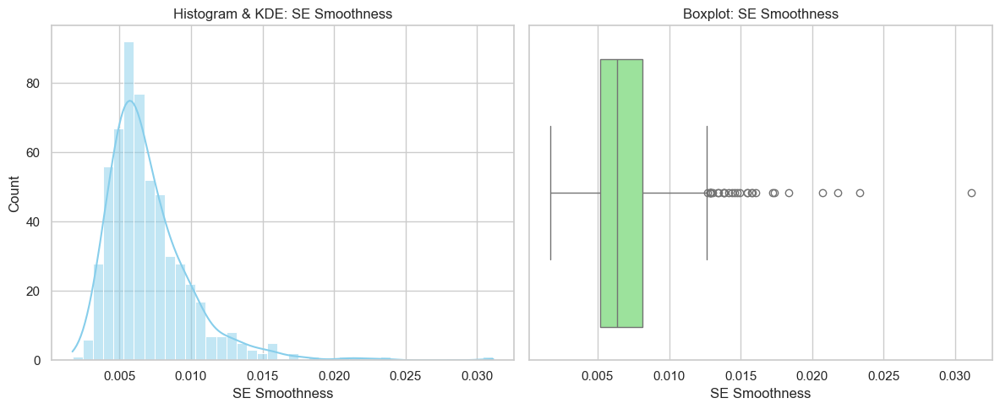


Normality Tests for SE Smoothness:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


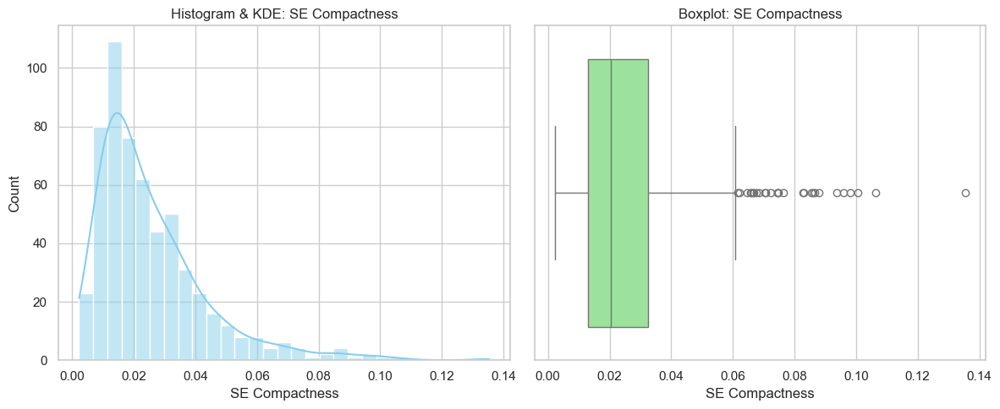


Normality Tests for SE Compactness:
Shapiro-Wilk: 1.0829572864000895e-23
D’Agostino’s K^2: 8.110584649898849e-52
Anderson-Darling: 22.780344254830197


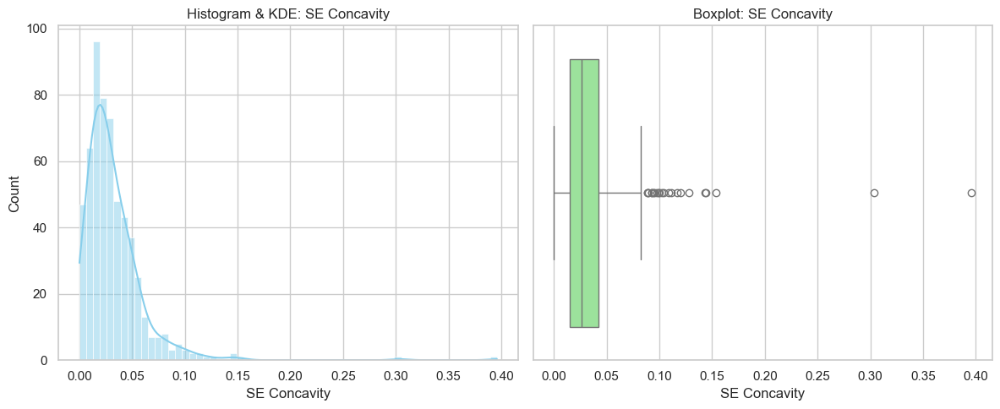


Normality Tests for SE Concavity:
Shapiro-Wilk: 1.1016811035207947e-31
D’Agostino’s K^2: 5.343479450682037e-139
Anderson-Darling: 28.799354374344603


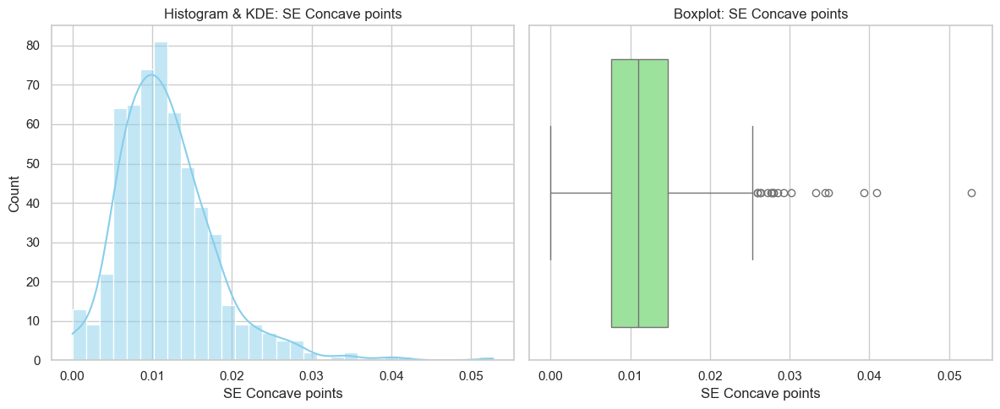


Normality Tests for SE Concave points:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


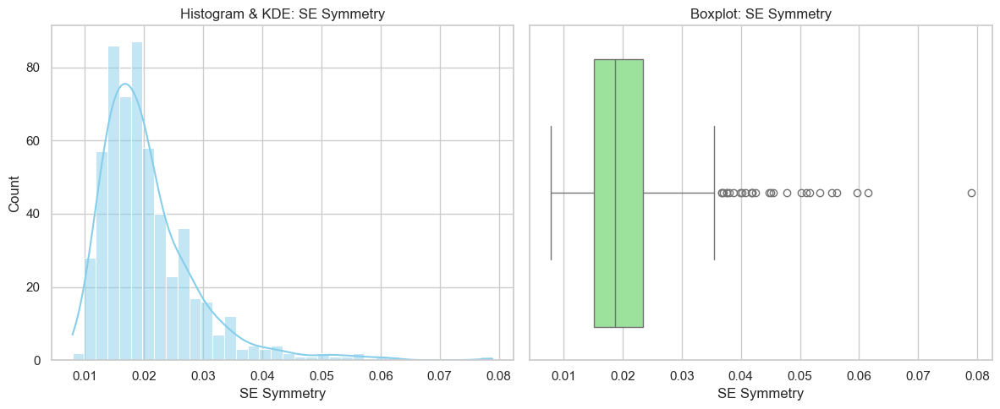


Normality Tests for SE Symmetry:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


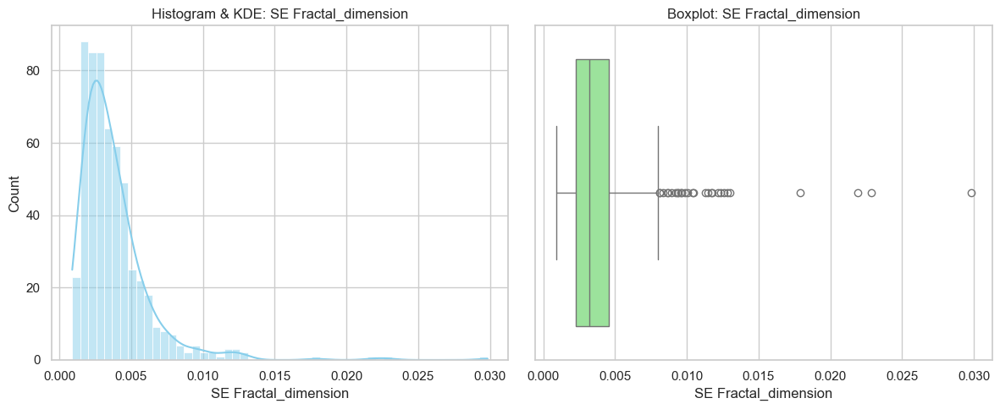


Normality Tests for SE Fractal_dimension:
Shapiro-Wilk: 8.551016628710327e-31
D’Agostino’s K^2: 1.3522748824773011e-112
Anderson-Darling: 33.23939459336805


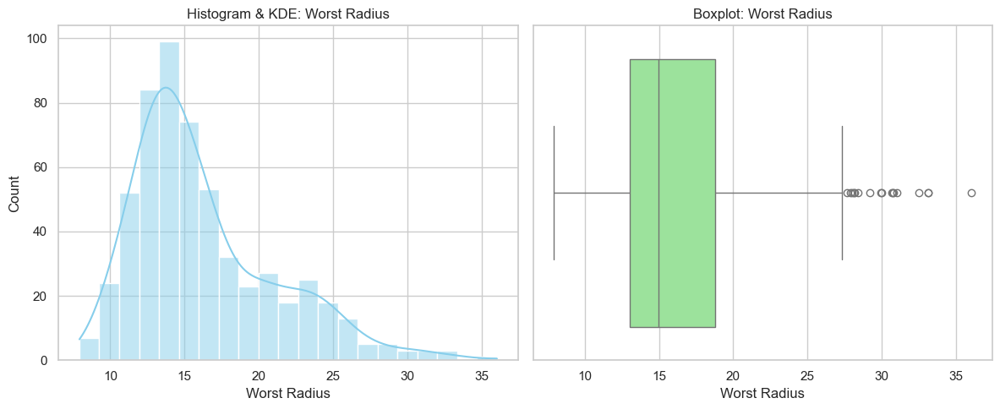


Normality Tests for Worst Radius:
Shapiro-Wilk: 1.7042937576417896e-17
D’Agostino’s K^2: 1.1932484193696656e-20
Anderson-Darling: 16.39483675446968


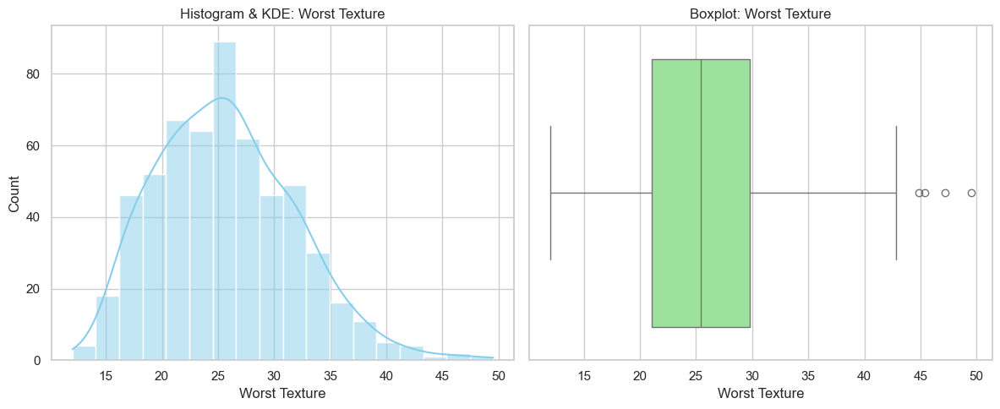


Normality Tests for Worst Texture:
Shapiro-Wilk: nan
D’Agostino’s K^2: nan
Anderson-Darling: nan


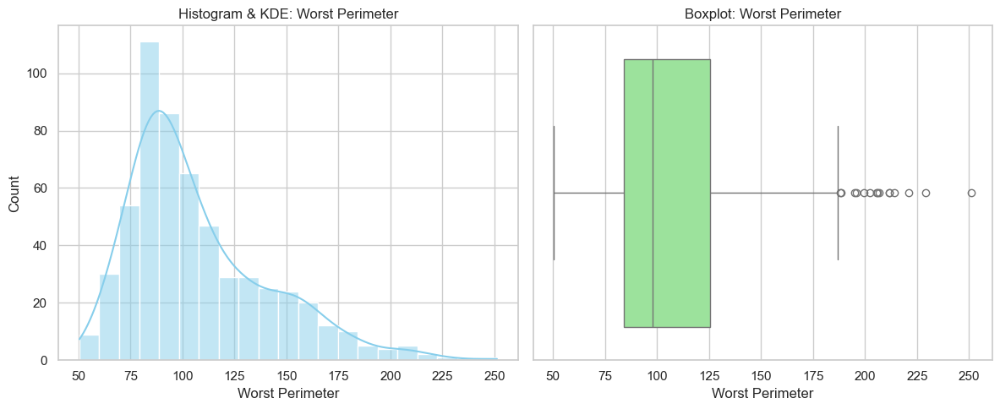


Normality Tests for Worst Perimeter:
Shapiro-Wilk: 1.3733357203511089e-17
D’Agostino’s K^2: 1.0795897623829055e-21
Anderson-Darling: 15.995232742238386


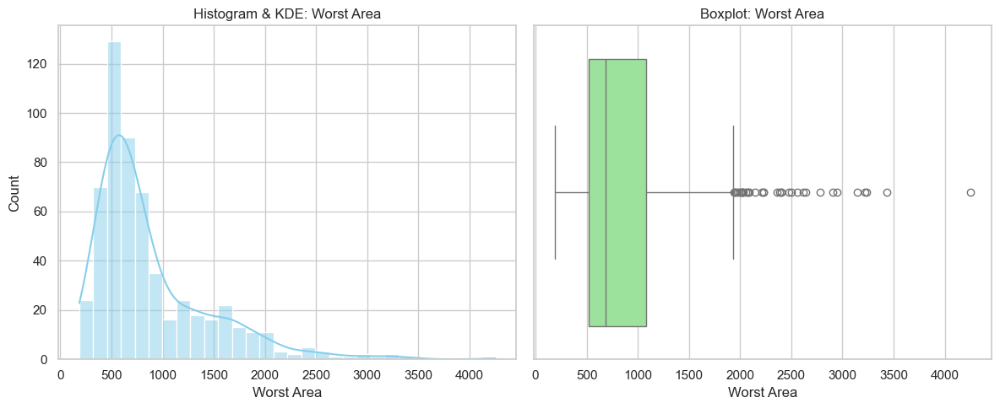


Normality Tests for Worst Area:
Shapiro-Wilk: 5.595364182395853e-25
D’Agostino’s K^2: 3.8349073670520574e-49
Anderson-Darling: 32.1149353503522


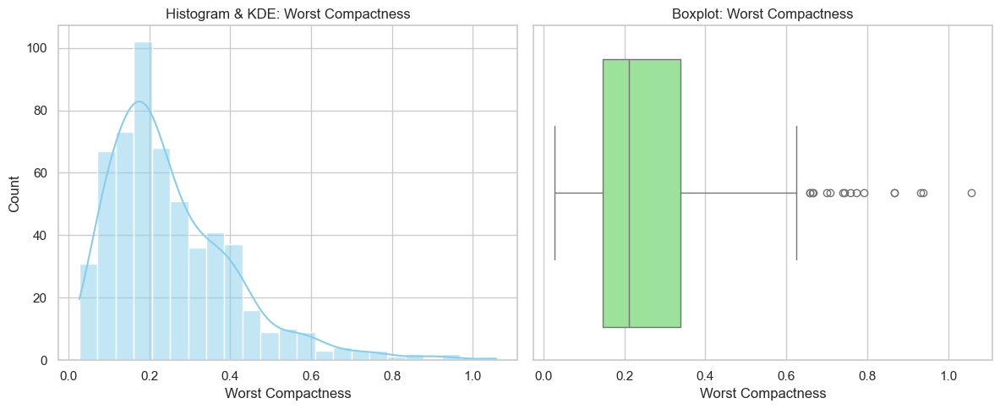


Normality Tests for Worst Compactness:
Shapiro-Wilk: 1.2474611873394349e-19
D’Agostino’s K^2: 1.3640836264500345e-36
Anderson-Darling: 14.325776662733006


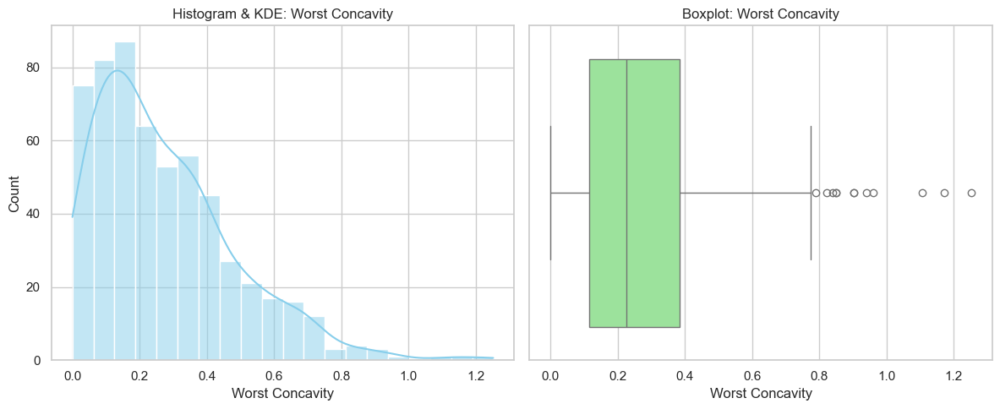


Normality Tests for Worst Concavity:
Shapiro-Wilk: 4.543300216578907e-17
D’Agostino’s K^2: 3.095891935387191e-24
Anderson-Darling: 11.028140348159695


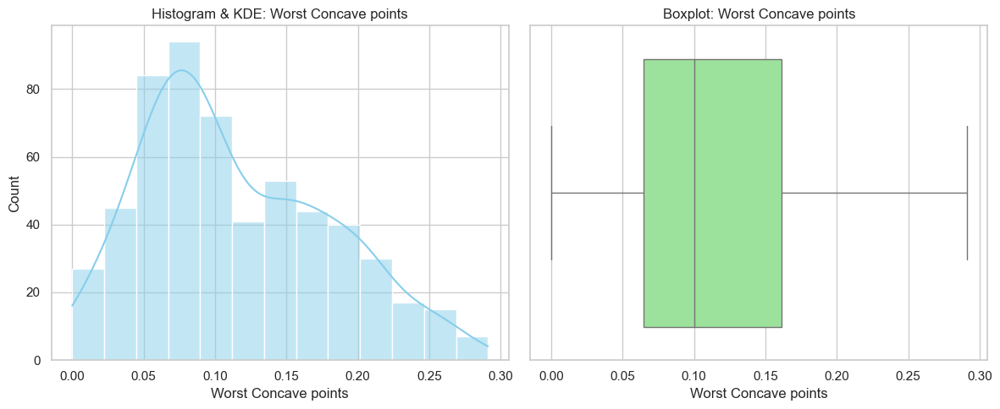


Normality Tests for Worst Concave points:
Shapiro-Wilk: 1.9848789180472218e-10
D’Agostino’s K^2: 4.744301759090309e-08
Anderson-Darling: 6.666824539721915


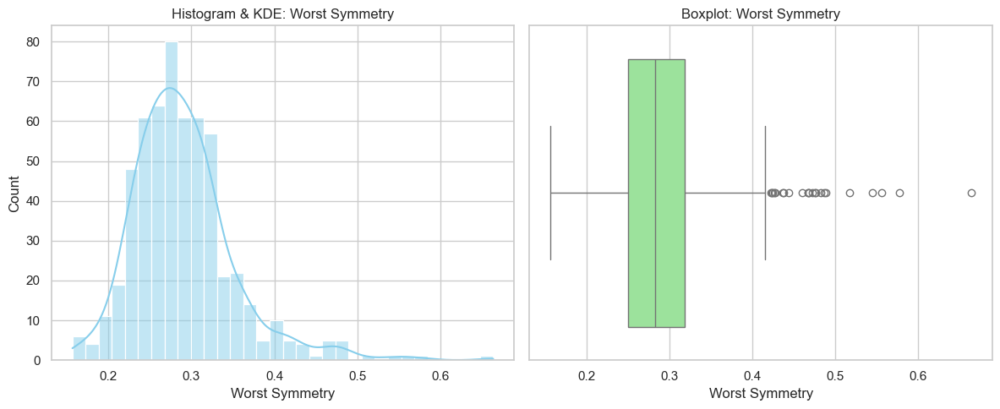


Normality Tests for Worst Symmetry:
Shapiro-Wilk: 3.233784235729834e-17
D’Agostino’s K^2: 1.286912411671778e-39
Anderson-Darling: 9.11439082320885


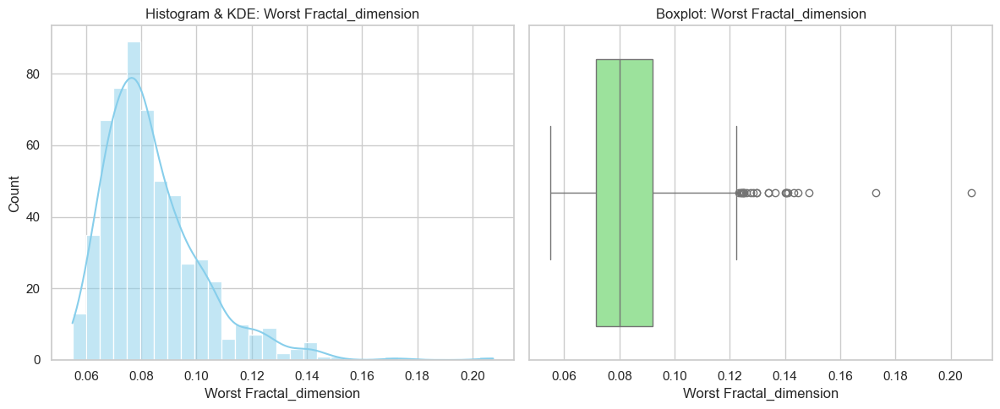


Normality Tests for Worst Fractal_dimension:
Shapiro-Wilk: 9.195144517319908e-20
D’Agostino’s K^2: 8.840764735694928e-47
Anderson-Darling: 13.489335884848288


In [105]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import shapiro, normaltest, anderson

# Assume df is your cleaned DataFrame
numerical_cols = df.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = df.select_dtypes(include=['object', 'category']).columns

# Univariate Visuals and Normality Test
for col in numerical_cols:
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    sns.histplot(df[col], kde=True, ax=axes[0], color='skyblue')
    sns.boxplot(x=df[col], ax=axes[1], color='lightgreen')
    axes[0].set_title(f'Histogram & KDE: {col}')
    axes[1].set_title(f'Boxplot: {col}')
    plt.tight_layout()
    plt.show()

    # Normality Tests
    print(f"\nNormality Tests for {col}:")
    print("Shapiro-Wilk:", shapiro(df[col])[1])
    print("D’Agostino’s K^2:", normaltest(df[col])[1])
    print("Anderson-Darling:", anderson(df[col]).statistic)
